## Train excluding past_laser power as input

In [1]:
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
if torch.cuda.is_available():
    print("cuda is available")
else:
    print("cuda is NOT available")

import numpy as np
from tqdm import tqdm
import pickle
import seaborn as sns
import matplotlib.pyplot as plt
import time
import copy
from moving_average import moving_average_1d

from policy import PolicyNN
from nn_functions import surrogate

import sys
sys.path.append('../1_model')
from TiDE import TideModule, quantile_loss  


cuda is available


In [2]:
df_all = pd.read_csv('../0_data/merged_df_2_99_temp_depth.csv')
df_all.shape

(610615, 12)

In [3]:
nan_rows = df_all[df_all.isna().any(axis=1)]
nan_rows

,time_index,melt_pool_temperature,melt_pool_depth,scanning_speed,X,Y,Z,Dist_to_nearest_X,Dist_to_nearest_Y,Dist_to_nearest_Z,Laser_power,laser_power_number
6293,224.912038,NaN,0.0,7.0,17.029661,-18.742469,7.5,2.970339,1.257531,0,614.885692,2
6294,224.947778,NaN,NaN,7.0,17.018514,-18.933201,7.5,2.981486,1.066799,0,614.893610,2
12588,224.912038,NaN,0.0,7.0,17.029661,-18.742469,7.5,2.970339,1.257531,0,633.345179,3
12589,224.947778,NaN,NaN,7.0,17.018514,-18.933201,7.5,2.981486,1.066799,0,633.341653,3
18883,224.912038,NaN,0.0,7.0,17.029661,-18.742469,7.5,2.970339,1.257531,0,683.646863,4
...,...,...,...,...,...,...,...,...,...,...,...,...
598024,224.947778,NaN,NaN,7.0,17.018514,-18.933201,7.5,2.981486,1.066799,0,642.786355,97
604318,224.912038,NaN,0.0,7.0,17.029661,-18.742469,7.5,2.970339,1.257531,0,676.289806,98
604319,224.947778,NaN,NaN,7.0,17.018514,-18.933201,7.5,2.981486,1.066799,0,676.285789,98
610613,224.912038,NaN,0.0,7.0,17.029661,-18.742469,7.5,2.970339,1.257531,0,655.685110,99


In [4]:
df_all = df_all.dropna()
df_all.shape

(610417, 12)

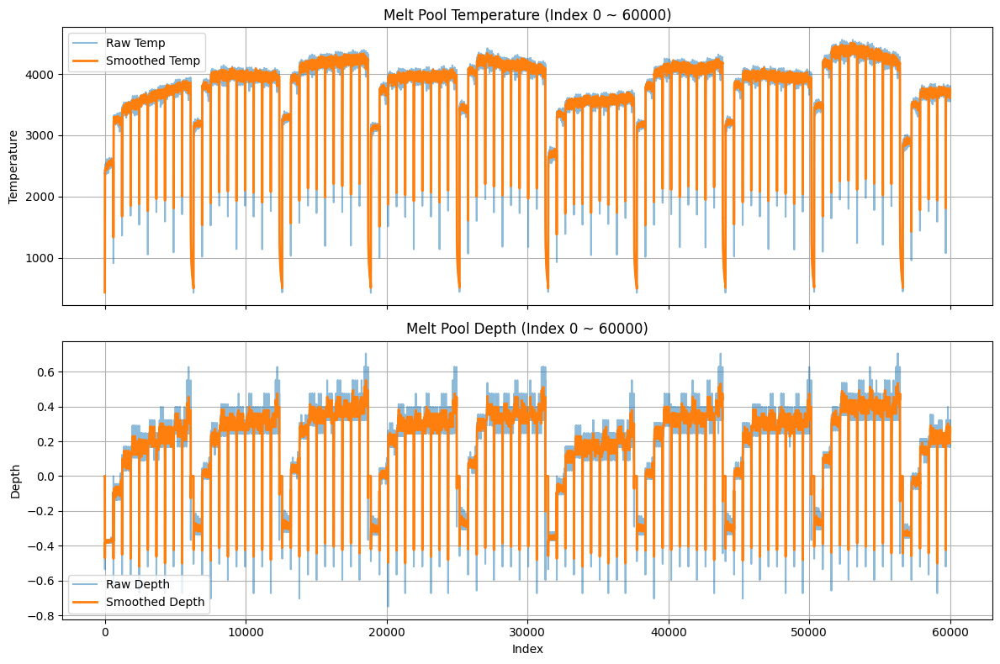

In [5]:
loc_X = df_all["X"].to_numpy().reshape(-1,1)
loc_Y = df_all["Y"].to_numpy().reshape(-1,1)
loc_Z = df_all["Z"].to_numpy().reshape(-1,1)
dist_X = df_all["Dist_to_nearest_X"].to_numpy().reshape(-1,1)
dist_Y = df_all["Dist_to_nearest_Y"].to_numpy().reshape(-1,1)
# dist_Z = df_all["Dist_to_nearest_Z"].to_numpy()[::2].reshape(-1,1)
scan_spd = df_all["scanning_speed"].to_numpy().reshape(-1,1)
laser_power = df_all["Laser_power"].to_numpy().reshape(-1,1)
laser_on_off = df_all["laser_power_number"].to_numpy().reshape(-1,1)

# apply moving average for mp temp
mp_temp_raw = df_all["melt_pool_temperature"].to_numpy()
mp_temp_mv = moving_average_1d(mp_temp_raw,4)
mp_temp = copy.deepcopy(mp_temp_raw)
mp_temp[1:-2] = mp_temp_mv
mp_temp = mp_temp.reshape(-1,1)

# apply moving average for mp depth
mp_depth_raw = df_all["melt_pool_depth"].to_numpy()
mp_depth_mv = moving_average_1d(mp_depth_raw,4)
mp_depth = copy.deepcopy(mp_depth_raw)
mp_depth[1:-2] = mp_depth_mv
mp_depth = mp_depth.reshape(-1,1)       

# Check
start = 00000
end = 60000
fig, axes = plt.subplots(2, 1, figsize=(12, 8), sharex=True)

axes[0].plot(range(start, end), mp_temp_raw[start:end], label='Raw Temp', alpha=0.5)
axes[0].plot(range(start, end), mp_temp[start:end], label='Smoothed Temp', linewidth=2)
axes[0].set_title(f"Melt Pool Temperature (Index {start} ~ {end})")
axes[0].set_ylabel("Temperature")
axes[0].legend()
axes[0].grid(True)

axes[1].plot(range(start, end), mp_depth_raw[start:end], label='Raw Depth', alpha=0.5)
axes[1].plot(range(start, end), mp_depth[start:end], label='Smoothed Depth', linewidth=2)
axes[1].set_title(f"Melt Pool Depth (Index {start} ~ {end})")
axes[1].set_xlabel("Index")
axes[1].set_ylabel("Depth")
axes[1].legend()
axes[1].grid(True)

plt.tight_layout()
plt.show()


In [6]:
# stack input array
x_original_scale = np.concatenate((loc_Z, dist_X, dist_Y, laser_power), axis=1)
y_original_scale = np.concatenate((mp_temp, mp_depth), axis=1)

In [7]:
# scaling
x_max = np.max(x_original_scale,0).reshape(1,-1)
x_min = np.min(x_original_scale,0).reshape(1,-1) 
y_max = np.max(y_original_scale,0).reshape(1,-1) 
y_min = np.min(y_original_scale,0).reshape(1,-1)

print("x_max:", np.round(x_max, 3).tolist())
print("x_min:", np.round(x_min, 3).tolist())
print("y_max:", np.round(y_max, 3).tolist())
print("y_min:", np.round(y_min, 3).tolist())


x_max: [[7.5, 20.0, 20.0, 732.298]]
x_min: [[0.0, 0.75, 0.75, 504.26]]
y_max: [[4509.855, 0.551]]
y_min: [[436.608, -0.559]]


In [8]:
class scalers():
    def __init__(self,x_max, x_min, y_max, y_min) -> None:
        self.x_max = x_max
        self.x_min = x_min
        self.y_max = y_max
        self.y_min = y_min
        
        return None
    
    def scaler_x(self, x_original, dim_id = -1):
        if dim_id == -1:
            x_s = -1 + 2 * ((x_original - self.x_min) / (self.x_max-self.x_min))
            return x_s
        else: 
            x_s = -1 + 2 * (x_original - self.x_min[0,dim_id]) / (self.x_max[0,dim_id] - self.x_min[0,dim_id])
            return x_s
    
    def inv_scaler_x(self, x_s, dim_id = -1):
        
        if dim_id == -1:
            x_original = (x_s + 1)*0.5*(self.x_max-self.x_min) + self.x_min
            return x_original
        else: 
            x_original = (x_s + 1)*0.5*(self.x_max[0,dim_id] - self.x_min[0,dim_id]) + self.x_min[0,dim_id]
            return x_original
        
    def scaler_y(self, y_original):
        return -1 + 2 * ((y_original - self.y_min) / (self.y_max-self.y_min))
    
    def inv_scaler_y(self, y_s):
        return (y_s + 1)*0.5*(self.y_max-self.y_min) + self.y_min

In [9]:
scaler = scalers(x_max, x_min, y_max, y_min)

x_s = scaler.scaler_x(x_original_scale)
y_s = scaler.scaler_y(y_original_scale)

print("x_s range:", np.min(x_s), "to", np.max(x_s))
print("y_s range:", np.min(y_s), "to", np.max(y_s))

print("x_s shape:", x_s.shape)
print("y_s shape:", y_s.shape)

x_s range: -1.0 to 1.0
y_s range: -1.0 to 1.0
x_s shape: (610417, 4)
y_s shape: (610417, 2)


In [10]:
length = y_s.shape[0]

# y_s_ref = np.random.uniform(0.0, 1.0, size=(length, 1))

e = 0.001
y_depth_low = np.random.uniform(0.1423-e, 0.1423+e, size=(length, 1))
y_depth_up = np.random.uniform(0.4126-e, 0.4126+e, size=(length, 1))
y_s_const = np.concatenate((y_depth_low, y_depth_up), axis=1)

# print("y_s_ref shape:", y_s_ref.shape)
print("y_s_const shape:", y_s_const.shape)

y_s_const shape: (610417, 2)


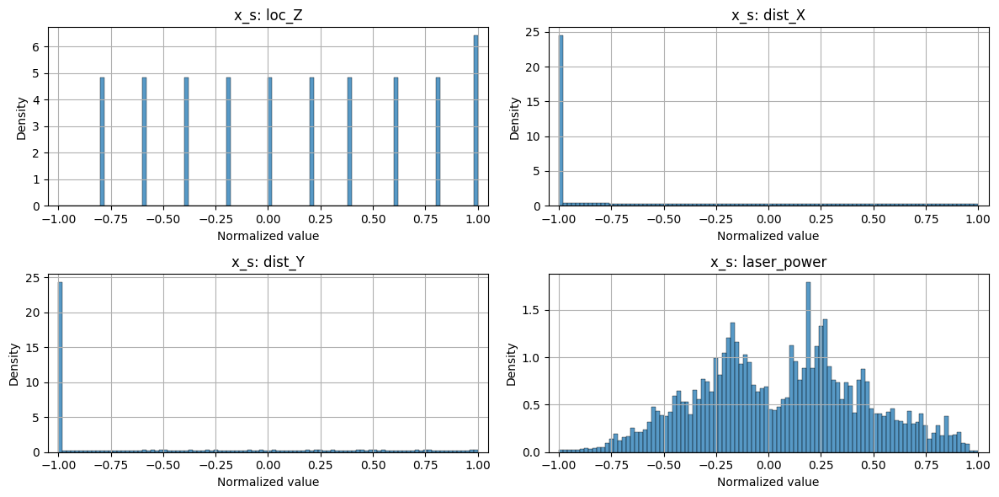

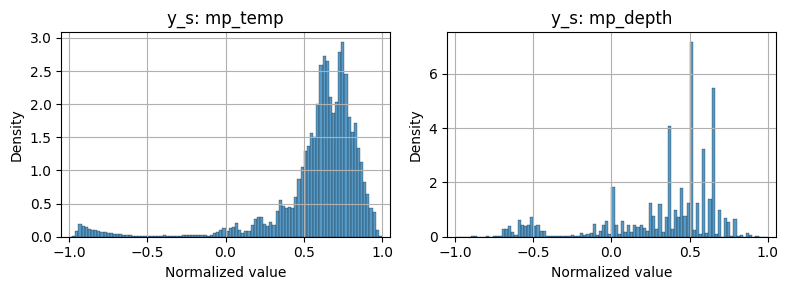

In [11]:
x_names = ['loc_Z', 'dist_X', 'dist_Y', 'laser_power']

plt.figure(figsize=(12, 6))
for i in range(x_s.shape[1]):
    plt.subplot(2, 2, i + 1)
    sns.histplot(x_s[:, i], bins=100, binrange=(-1, 1), kde=False, stat='density')
    plt.title(f'x_s: {x_names[i]}')
    plt.xlabel('Normalized value')
    plt.ylabel('Density')
    plt.xlim(-1.05, 1.05)
    plt.grid(True)
plt.tight_layout()
plt.show()

y_names = ['mp_temp', 'mp_depth']

plt.figure(figsize=(8, 3))
for i in range(y_s.shape[1]):
    plt.subplot(1, 2, i + 1)
    sns.histplot(y_s[:, i], bins=100, binrange=(-1, 1), kde=False, stat='density')
    plt.title(f'y_s: {y_names[i]}')
    plt.xlabel('Normalized value')
    plt.ylabel('Density')
    plt.xlim(-1.05, 1.05)
    plt.grid(True)
plt.tight_layout()
plt.show()



In [12]:
# 기본 분할
cutoff_index = int(np.round(0.9 * x_s.shape[0]))
x_train, y_train = x_s[:cutoff_index], y_s[:cutoff_index]
x_val, y_val = x_s[cutoff_index:], y_s[cutoff_index:]
# y_ref_train, y_ref_val = y_s_ref[:cutoff_index], y_s_ref[cutoff_index:]
y_const_train, y_const_val = y_s_const[:cutoff_index], y_s_const[cutoff_index:]

window = 50
P = 50

# ------------------ Training set ------------------
n_train = cutoff_index - P - window
x_past_train = np.empty((n_train, window, 4))
y_past_train = np.empty((n_train, window, 2))
x_future_train = np.empty((n_train, P, 3))
y_ref_train_seq = np.empty((n_train, P, 1))
y_const_train_seq = np.empty((n_train, P, 2))

for i in tqdm(range(window, cutoff_index - P)):
    j = i - window
    x_past_train[j] = x_train[i-window:i]
    y_past_train[j] = y_train[i-window:i]
    x_future_train[j] = x_train[i:i+P, :3]         # 앞에서 3개
    y_ref_train_seq[j] = y_train[i:i+P, :1]  
    # y_ref_train_seq[j] = y_ref_train[i:i+P]
    y_const_train_seq[j] = y_const_train[i:i+P]

# ------------------ Validation set ------------------
val_cutoff = x_s.shape[0] - cutoff_index
n_val = val_cutoff - P - window
x_past_val = np.empty((n_val, window, 4))
y_past_val = np.empty((n_val, window, 2))
x_future_val = np.empty((n_val, P, 3))
y_ref_val_seq = np.empty((n_val, P, 1))
y_const_val_seq = np.empty((n_val, P, 2))

for i in tqdm(range(window, val_cutoff - P)):
    j = i - window
    x_past_val[j] = x_val[i-window:i]
    y_past_val[j] = y_val[i-window:i]
    x_future_val[j] = x_val[i:i+P, :3]
    y_ref_val_seq[j] = y_val[i:i+P, :1]  
    # y_ref_val_seq[j] = y_ref_val[i:i+P]
    y_const_val_seq[j] = y_const_val[i:i+P]

x_past_train = torch.tensor(x_past_train, dtype=torch.float32)
y_past_train = torch.tensor(y_past_train, dtype=torch.float32)
x_future_train = torch.tensor(x_future_train, dtype=torch.float32)
y_ref_train_seq = torch.tensor(y_ref_train_seq, dtype=torch.float32)
y_const_train_seq = torch.tensor(y_const_train_seq, dtype=torch.float32)

print("x_past shape : ", x_past_train.shape)       # (n_train, 50, 4)
print("y_past shape : ",y_past_train.shape)       # (n_train, 50, 2)
print("x_future shape : ",x_future_train.shape)     # (n_train, 50, 3)
print("y_ref shape : ",y_ref_train_seq.shape)    # (n_train, 50, 1)
print("y_const shape : ",y_const_train_seq.shape)  # (n_train, 50, 2)

x_past_val = torch.tensor(x_past_val, dtype=torch.float32)
y_past_val = torch.tensor(y_past_val, dtype=torch.float32)
x_future_val = torch.tensor(x_future_val, dtype=torch.float32)
y_ref_val_seq = torch.tensor(y_ref_val_seq, dtype=torch.float32)
y_const_val_seq = torch.tensor(y_const_val_seq, dtype=torch.float32)

print("x_past_val shape : ", x_past_val.shape)       # (n_val, 50, 4)
print("y_past_val shape : ", y_past_val.shape)       # (n_val, 50, 2)
print("x_future_val shape : ", x_future_val.shape)   # (n_val, 50, 3)
print("y_ref_val shape : ", y_ref_val_seq.shape)     # (n_val, 50, 1)
print("y_const_val shape : ", y_const_val_seq.shape) # (n_val, 50, 2)

x_past_train[:,:,3] = 0
x_past_val[:,:,3] = 0

100%|██████████| 60942/60942 [00:00<00:00, 237868.34it/s]


x_past shape :  torch.Size([549275, 50, 4])
y_past shape :  torch.Size([549275, 50, 2])
x_future shape :  torch.Size([549275, 50, 3])
y_ref shape :  torch.Size([549275, 50, 1])
y_const shape :  torch.Size([549275, 50, 2])
x_past_val shape :  torch.Size([60942, 50, 4])
y_past_val shape :  torch.Size([60942, 50, 2])
x_future_val shape :  torch.Size([60942, 50, 3])
y_ref_val shape :  torch.Size([60942, 50, 1])
y_const_val shape :  torch.Size([60942, 50, 2])


In [13]:
def plot_kth_sample_simple(k, x_past, y_past, x_future, y_ref, title=""):
    time_past = np.arange(50)
    time_future = np.arange(50, 100)

    plt.figure(figsize=(12, 6))

    # 1. x_past + x_future (Z, DistX, DistY, Control)
    plt.subplot(2, 1, 1)
    plt.plot(time_past, x_past[k,:,0], label="Z (past)")
    plt.plot(time_past, x_past[k,:,1], label="Dist X (past)")
    plt.plot(time_past, x_past[k,:,2], label="Dist Y (past)")
    plt.plot(time_past, x_past[k,:,3], label="Control (past)")

    plt.plot(time_future, x_future[k,:,0], '--', label="Z (future)")
    plt.plot(time_future, x_future[k,:,1], '--', label="Dist X (future)")
    plt.plot(time_future, x_future[k,:,2], '--', label="Dist Y (future)")

    plt.ylabel("x inputs")
    plt.legend()
    plt.grid()

    # 2. y_past + y_ref (Temp, Depth)
    plt.subplot(2, 1, 2)
    plt.plot(time_past, y_past[k,:,0], label="Temp (past)")
    plt.plot(time_past, y_past[k,:,1], label="Depth (past)")

    plt.plot(time_future, y_ref[k,:,0], '--', label="Temp (ref future)")

    plt.xlabel("Time")
    plt.ylabel("y outputs")
    plt.legend()
    plt.grid()

    plt.suptitle(f"{title} sample #{k}")
    plt.tight_layout()
    plt.show()


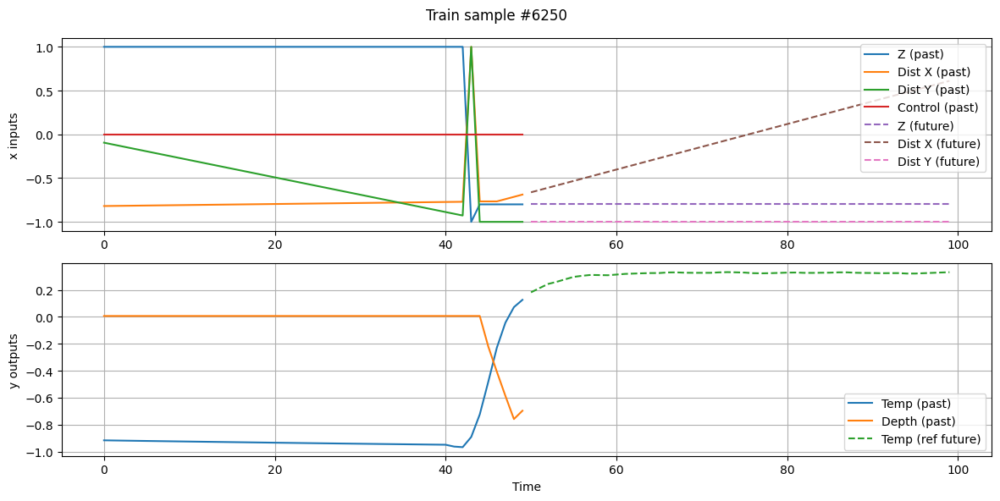

In [14]:
plot_kth_sample_simple(
    k=6250,
    x_past=x_past_train.numpy(),
    y_past=y_past_train.numpy(),
    x_future=x_future_train.numpy(),
    y_ref=y_ref_train_seq.numpy(),
    title="Train"
)


In [15]:
import torch
import pickle

# Load model
with open('TiDE_params_single_track_square_MV_temp_depth_less_cov_0915_w50_p50.pkl', 'rb') as file:
    nominal_params = pickle.load(file)

TiDE = nominal_params['model'].to(device)
total_params = sum(p.numel() for p in TiDE.parameters())
print(f'Total number of parameters: {total_params}')
print(TiDE)

# Extract model dimensions
input_chunk_length = TiDE.input_chunk_length
output_chunk_length = TiDE.output_chunk_length
input_dim = TiDE.input_dim
output_dim = TiDE.output_dim
past_cov_dim = TiDE.past_cov_dim
future_cov_dim = TiDE.future_cov_dim
static_cov_dim = TiDE.static_cov_dim
nr_params = TiDE.nr_params

print("input_chunk_length:", input_chunk_length)
print("output_chunk_length:", output_chunk_length)
print("input_dim:", input_dim)
print("output_dim:", output_dim)
print("past_cov_dim:", past_cov_dim)
print("future_cov_dim:", future_cov_dim)
print("static_cov_dim:", static_cov_dim)
print("nr_params:", nr_params)

# Generate dummy input
B = 1  # batch size
x_past = torch.randn(B, input_chunk_length, input_dim)
x_future_covariates = torch.randn(B, output_chunk_length, future_cov_dim) if future_cov_dim > 0 else None
x_static_covariates = torch.randn(B, static_cov_dim) if static_cov_dim > 0 else None

# Move to device
x_past = x_past.to(device)
if x_future_covariates is not None:
    x_future_covariates = x_future_covariates.to(device)
if x_static_covariates is not None:
    x_static_covariates = x_static_covariates.to(device)

# Run model
x_in = (x_past, x_future_covariates, x_static_covariates)
y = TiDE(x_in)

# Print shapes
print("Input shape:")
print("  x_past:", x_past.shape)
if x_future_covariates is not None:
    print("  x_future_covariates:", x_future_covariates.shape)
if x_static_covariates is not None:
    print("  x_static_covariates:", x_static_covariates.shape)

print("Output shape:", y.shape)  # (B, output_chunk_length, output_dim, nr_params)

Total number of parameters: 796594
TideModule(
  (future_cov_projection): ResidualBlock(
    (dense): Sequential(
      (0): Linear(in_features=4, out_features=128, bias=True)
      (1): ReLU()
      (2): Linear(in_features=128, out_features=4, bias=True)
      (3): Dropout(p=0.2, inplace=False)
    )
    (skip): Linear(in_features=4, out_features=4, bias=True)
    (layer_norm): LayerNorm((4,), eps=1e-05, elementwise_affine=True)
  )
  (encoders): Sequential(
    (0): ResidualBlock(
      (dense): Sequential(
        (0): Linear(in_features=500, out_features=128, bias=True)
        (1): ReLU()
        (2): Linear(in_features=128, out_features=128, bias=True)
        (3): Dropout(p=0.2, inplace=False)
      )
      (skip): Linear(in_features=500, out_features=128, bias=True)
      (layer_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
    )
  )
  (decoders): Sequential(
    (0): ResidualBlock(
      (dense): Sequential(
        (0): Linear(in_features=128, out_features=128,

In [16]:
batch_size = 512

# Make sure your training/validation tensors are torch.Tensor before this line
train_dataset = TensorDataset(x_past_train, y_past_train, x_future_train, y_ref_train_seq, y_const_train_seq)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

val_dataset = TensorDataset(x_past_val, y_past_val, x_future_val, y_ref_val_seq, y_const_val_seq)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)


# loss function


In [17]:
## loss on initial 10 steps

def DPC_loss(tide_output: torch.Tensor, reference: torch.Tensor, u_output: torch.Tensor, constraint: torch.Tensor,
             w_tracking=1.0, w_smooth=0.1, w_constraint=3.0):
    tide_output = tide_output.median(dim=-1).values
    tide_output_temp = tide_output[:, :, 0]
    reference = reference[:, :, 0]
    tracking_loss = (reference - tide_output_temp) ** 2

    u_diff = u_output[:, 1:, :] - u_output[:, :-1, :]
    smoothness_loss = u_diff ** 2

    tide_output_depth = tide_output[:, :, 1]
    low_violation = torch.relu(constraint[:, :, 0] - tide_output_depth) ** 2
    up_violation = torch.relu(tide_output_depth - constraint[:, :, 1]) ** 2
    constraint_loss = 0 * low_violation + up_violation

    loss = (
        w_tracking * torch.sqrt(tracking_loss.mean()) +
        w_smooth * torch.sqrt(smoothness_loss.mean()) +
        w_constraint * torch.sqrt(constraint_loss.mean())
    )
    return loss


In [18]:
import pickle
import os

def train_and_evaluate(n_layers, hidden_dim, setting_name,
                       w_smooth=0.1, w_constraint=3.0):
    model = PolicyNN(
        past_input_dim=6,
        future_input_dim=6,
        output_dim=1,
        p=50,
        window=50,
        hidden_dim=hidden_dim,
        n_layers=n_layers,
        dropout_p=0.1
    ).to(device)

    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.95)

    best_model = None
    best_val_loss = float("inf")
    save_train_loss = np.zeros(num_epoch)
    save_val_loss = np.zeros(num_epoch)
    counter = 0

    with tqdm(total=num_epoch, desc=setting_name) as pbar:
        for epoch in range(num_epoch):
            for x_past, y_past, x_future, y_ref, y_const in train_loader:
                x_past, y_past, x_future, y_ref, y_const = (
                    x_past.to(device), y_past.to(device),
                    x_future.to(device), y_ref.to(device), y_const.to(device)
                )

                policy_in_past = torch.cat((x_past, y_past), dim=2)
                policy_in_future = torch.cat((x_future, y_ref, y_const), dim=2)

                model.train()
                optimizer.zero_grad()

                u_output = model((policy_in_past, policy_in_future))
                x_future_tide = torch.cat((x_future, u_output), dim=2)
                past_cov = torch.cat((y_past, x_past), dim=2)

                tide_pred = TiDE((past_cov, x_future_tide, None))
                loss = DPC_loss(tide_pred, y_ref, u_output, y_const,
                                w_tracking=1.0, w_smooth=w_smooth, w_constraint=w_constraint)

                loss.backward()
                for name, param in model.named_parameters():
                    if param.grad is not None:
                        print(f"[GradNorm] {name}: {param.grad.norm().item():.2e}")

                optimizer.step()

            # validation
            model.eval()
            val_loss_total = 0.0
            num_val_batches = 0

            with torch.no_grad():
                for val_x_past, val_y_past, val_x_future, val_y_ref, val_y_const in val_loader:
                    val_x_past, val_y_past, val_x_future, val_y_ref, val_y_const = (
                        val_x_past.to(device), val_y_past.to(device),
                        val_x_future.to(device), val_y_ref.to(device), val_y_const.to(device)
                    )

                    val_policy_in_past = torch.cat((val_x_past, val_y_past), dim=2)
                    val_policy_in_fut = torch.cat((val_x_future, val_y_ref, val_y_const), dim=2)

                    val_u_output = model((val_policy_in_past, val_policy_in_fut))

                    x_future_tide_val = torch.cat((val_x_future, val_u_output), dim=2)
                    past_cov_val = torch.cat((val_y_past, val_x_past), dim=2)

                    val_tide_pred = TiDE((past_cov_val, x_future_tide_val, None))
                    val_loss = DPC_loss(val_tide_pred, val_y_ref, val_u_output, val_y_const,
                                        w_tracking=1.0, w_smooth=w_smooth, w_constraint=w_constraint)

                    val_loss_total += val_loss.item()
                    num_val_batches += 1

            val_loss_avg = val_loss_total / num_val_batches

            if val_loss_avg < best_val_loss:
                best_val_loss = val_loss_avg
                best_model = model.state_dict()
                counter = 0
            else:
                counter += 1
                if counter >= patience:
                    break

            save_train_loss[epoch] = loss.item()
            save_val_loss[epoch] = val_loss_avg
            scheduler.step()
            pbar.set_description(f"{setting_name} | Epoch {epoch} | Train: {loss.item():.4f} | Val: {val_loss_avg:.4f}")
            pbar.update(1)


    # directory where you want to store all results
    train_dir = "/home/ftk3187/github/DPC_research/02_DED/2_policy/trainresults"
    os.makedirs(train_dir, exist_ok=True)

    # build filename and full path
    model_filename = f"policy_model_0716_wo_pastlaser_lr1e-4_{setting_name}.pth"
    model_path = os.path.join(train_dir, model_filename)

    # save and report
    torch.save(best_model, model_path)
    print(f"Saved model to: {model_path}")

    # Save model parameters as .pkl
    model_params = {
        "model_name": setting_name,
        "past_input_dim": 6,
        "future_input_dim": 6,
        "output_dim": 1,
        "future_cov_dim": 2,
        "static_cov_dim": 0,
        "window": 50,
        "p": 50,
        "hidden_dim": hidden_dim,
        "n_layers": n_layers,
        "learning_rate": learning_rate,
        "weight_decay": weight_decay,
        "num_epoch": num_epoch,
        "w_smooth": w_smooth,
        "w_constraint": w_constraint
    }

    train_dir = "/home/ftk3187/github/DPC_research/02_DED/2_policy/trainresults"
    os.makedirs(train_dir, exist_ok=True)

    # save model parameters
    param_filename = f"policy_parameters_0716_wo_pastlaser_lr1e-4_{setting_name}.pkl"
    param_path = os.path.join(train_dir, param_filename)
    with open(param_path, "wb") as f:
        pickle.dump(model_params, f)
    print(f"Saved model parameters to: {param_path}")

    return {
        "train_loss": save_train_loss,
        "val_loss": save_val_loss
    }


In [19]:
import torch
import os
from torch.utils.data import DataLoader, TensorDataset
from tqdm import tqdm
import numpy as np
import pickle
from policy import PolicyNN

# Hyperparameters
num_epoch = 50
batch_size = 256
learning_rate = 1e-4
weight_decay = 1e-5
patience = 100

target_configs = [
    (3, 1024, 0, 0),  # s0c0
    (3, 1024, 1, 1),  # s1c1
    (3, 1024, 2, 2),  # s2c2
]

# Results dictionary
results = {}

# Run training for each configuration
for n_layers, hidden_dim, w_smooth, w_constraint in target_configs:
    setting_name = f"{n_layers}L_{hidden_dim}H_s{w_smooth}_c{w_constraint}"
    print(f"\n▶ Training model: {setting_name}")

    result = train_and_evaluate(
        n_layers=n_layers,
        hidden_dim=hidden_dim,
        setting_name=setting_name,
        w_smooth=w_smooth,
        w_constraint=w_constraint
    )
    results[setting_name] = result



▶ Training model: 3L_1024H_s0_c0


3L_1024H_s0_c0:   0%|          | 0/50 [00:00<?, ?it/s]

[GradNorm] input_layer.weight: 2.61e-01
[GradNorm] input_layer.bias: 1.92e-02
[GradNorm] input_ln.weight: 6.54e-03
[GradNorm] input_ln.bias: 6.91e-03
[GradNorm] hidden_layers.0.weight: 2.50e-01
[GradNorm] hidden_layers.0.bias: 1.23e-02
[GradNorm] norm_layers.0.weight: 5.14e-03
[GradNorm] norm_layers.0.bias: 5.39e-03
[GradNorm] output_layer.weight: 4.85e-01
[GradNorm] output_layer.bias: 1.46e-02
[GradNorm] input_layer.weight: 3.01e-01
[GradNorm] input_layer.bias: 2.12e-02
[GradNorm] input_ln.weight: 7.65e-03
[GradNorm] input_ln.bias: 7.95e-03
[GradNorm] hidden_layers.0.weight: 2.87e-01
[GradNorm] hidden_layers.0.bias: 1.36e-02
[GradNorm] norm_layers.0.weight: 6.10e-03
[GradNorm] norm_layers.0.bias: 6.02e-03
[GradNorm] output_layer.weight: 5.43e-01
[GradNorm] output_layer.bias: 1.58e-02
[GradNorm] input_layer.weight: 2.31e-01
[GradNorm] input_layer.bias: 1.97e-02
[GradNorm] input_ln.weight: 6.42e-03
[GradNorm] input_ln.bias: 7.11e-03
[GradNorm] hidden_layers.0.weight: 2.40e-01
[GradNorm]

3L_1024H_s0_c0 | Epoch 0 | Train: 0.0326 | Val: 0.0286:   2%|▏         | 1/50 [00:23<19:32, 23.93s/it]

[GradNorm] input_layer.weight: 5.84e-02
[GradNorm] input_layer.bias: 3.46e-03
[GradNorm] input_ln.weight: 8.11e-04
[GradNorm] input_ln.bias: 1.18e-03
[GradNorm] hidden_layers.0.weight: 3.01e-02
[GradNorm] hidden_layers.0.bias: 1.71e-03
[GradNorm] norm_layers.0.weight: 6.17e-04
[GradNorm] norm_layers.0.bias: 7.95e-04
[GradNorm] output_layer.weight: 7.69e-02
[GradNorm] output_layer.bias: 2.65e-03
[GradNorm] input_layer.weight: 7.38e-02
[GradNorm] input_layer.bias: 5.19e-03
[GradNorm] input_ln.weight: 1.13e-03
[GradNorm] input_ln.bias: 1.75e-03
[GradNorm] hidden_layers.0.weight: 4.52e-02
[GradNorm] hidden_layers.0.bias: 2.84e-03
[GradNorm] norm_layers.0.weight: 8.87e-04
[GradNorm] norm_layers.0.bias: 1.28e-03
[GradNorm] output_layer.weight: 1.41e-01
[GradNorm] output_layer.bias: 5.28e-03
[GradNorm] input_layer.weight: 5.54e-02
[GradNorm] input_layer.bias: 4.11e-03
[GradNorm] input_ln.weight: 7.92e-04
[GradNorm] input_ln.bias: 1.32e-03
[GradNorm] hidden_layers.0.weight: 3.30e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 1 | Train: 0.0334 | Val: 0.0263:   4%|▍         | 2/50 [00:45<18:10, 22.72s/it]

[GradNorm] input_layer.weight: 5.21e-02
[GradNorm] input_layer.bias: 3.10e-03
[GradNorm] input_ln.weight: 6.73e-04
[GradNorm] input_ln.bias: 1.05e-03
[GradNorm] hidden_layers.0.weight: 2.52e-02
[GradNorm] hidden_layers.0.bias: 1.40e-03
[GradNorm] norm_layers.0.weight: 5.13e-04
[GradNorm] norm_layers.0.bias: 6.58e-04
[GradNorm] output_layer.weight: 5.81e-02
[GradNorm] output_layer.bias: 1.23e-03
[GradNorm] input_layer.weight: 7.46e-02
[GradNorm] input_layer.bias: 6.29e-03
[GradNorm] input_ln.weight: 9.20e-04
[GradNorm] input_ln.bias: 1.93e-03
[GradNorm] hidden_layers.0.weight: 3.25e-02
[GradNorm] hidden_layers.0.bias: 2.49e-03
[GradNorm] norm_layers.0.weight: 7.50e-04
[GradNorm] norm_layers.0.bias: 1.05e-03
[GradNorm] output_layer.weight: 1.07e-01
[GradNorm] output_layer.bias: 4.50e-03
[GradNorm] input_layer.weight: 5.73e-02
[GradNorm] input_layer.bias: 4.78e-03
[GradNorm] input_ln.weight: 6.71e-04
[GradNorm] input_ln.bias: 1.38e-03
[GradNorm] hidden_layers.0.weight: 2.68e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 2 | Train: 0.0301 | Val: 0.0251:   6%|▌         | 3/50 [01:07<17:35, 22.46s/it]

[GradNorm] input_layer.weight: 6.18e-02
[GradNorm] input_layer.bias: 4.03e-03
[GradNorm] input_ln.weight: 8.28e-04
[GradNorm] input_ln.bias: 1.51e-03
[GradNorm] hidden_layers.0.weight: 2.67e-02
[GradNorm] hidden_layers.0.bias: 1.75e-03
[GradNorm] norm_layers.0.weight: 5.99e-04
[GradNorm] norm_layers.0.bias: 8.78e-04
[GradNorm] output_layer.weight: 7.36e-02
[GradNorm] output_layer.bias: 2.64e-03
[GradNorm] input_layer.weight: 4.67e-02
[GradNorm] input_layer.bias: 2.86e-03
[GradNorm] input_ln.weight: 6.10e-04
[GradNorm] input_ln.bias: 1.06e-03
[GradNorm] hidden_layers.0.weight: 1.90e-02
[GradNorm] hidden_layers.0.bias: 1.22e-03
[GradNorm] norm_layers.0.weight: 4.08e-04
[GradNorm] norm_layers.0.bias: 5.09e-04
[GradNorm] output_layer.weight: 4.11e-02
[GradNorm] output_layer.bias: 1.19e-03
[GradNorm] input_layer.weight: 8.84e-02
[GradNorm] input_layer.bias: 5.14e-03
[GradNorm] input_ln.weight: 1.07e-03
[GradNorm] input_ln.bias: 1.96e-03
[GradNorm] hidden_layers.0.weight: 3.33e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 3 | Train: 0.0295 | Val: 0.0244:   8%|▊         | 4/50 [01:31<17:26, 22.76s/it]

[GradNorm] input_layer.weight: 6.34e-02
[GradNorm] input_layer.bias: 3.78e-03
[GradNorm] input_ln.weight: 7.51e-04
[GradNorm] input_ln.bias: 1.46e-03
[GradNorm] hidden_layers.0.weight: 2.26e-02
[GradNorm] hidden_layers.0.bias: 1.58e-03
[GradNorm] norm_layers.0.weight: 5.27e-04
[GradNorm] norm_layers.0.bias: 7.70e-04
[GradNorm] output_layer.weight: 6.22e-02
[GradNorm] output_layer.bias: 2.16e-03
[GradNorm] input_layer.weight: 4.75e-02
[GradNorm] input_layer.bias: 3.73e-03
[GradNorm] input_ln.weight: 5.63e-04
[GradNorm] input_ln.bias: 1.22e-03
[GradNorm] hidden_layers.0.weight: 1.92e-02
[GradNorm] hidden_layers.0.bias: 1.77e-03
[GradNorm] norm_layers.0.weight: 4.99e-04
[GradNorm] norm_layers.0.bias: 6.85e-04
[GradNorm] output_layer.weight: 8.38e-02
[GradNorm] output_layer.bias: 4.16e-03
[GradNorm] input_layer.weight: 3.77e-02
[GradNorm] input_layer.bias: 2.75e-03
[GradNorm] input_ln.weight: 5.71e-04
[GradNorm] input_ln.bias: 1.07e-03
[GradNorm] hidden_layers.0.weight: 1.79e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 4 | Train: 0.0300 | Val: 0.0246:  10%|█         | 5/50 [01:50<16:09, 21.54s/it]

[GradNorm] input_layer.weight: 6.48e-02
[GradNorm] input_layer.bias: 4.49e-03
[GradNorm] input_ln.weight: 8.52e-04
[GradNorm] input_ln.bias: 1.77e-03
[GradNorm] hidden_layers.0.weight: 2.44e-02
[GradNorm] hidden_layers.0.bias: 2.11e-03
[GradNorm] norm_layers.0.weight: 6.38e-04
[GradNorm] norm_layers.0.bias: 9.25e-04
[GradNorm] output_layer.weight: 7.88e-02
[GradNorm] output_layer.bias: 3.47e-03
[GradNorm] input_layer.weight: 5.02e-02
[GradNorm] input_layer.bias: 4.34e-03
[GradNorm] input_ln.weight: 7.52e-04
[GradNorm] input_ln.bias: 1.72e-03
[GradNorm] hidden_layers.0.weight: 2.24e-02
[GradNorm] hidden_layers.0.bias: 2.26e-03
[GradNorm] norm_layers.0.weight: 6.47e-04
[GradNorm] norm_layers.0.bias: 8.03e-04
[GradNorm] output_layer.weight: 7.42e-02
[GradNorm] output_layer.bias: 3.76e-03
[GradNorm] input_layer.weight: 5.44e-02
[GradNorm] input_layer.bias: 4.10e-03
[GradNorm] input_ln.weight: 6.69e-04
[GradNorm] input_ln.bias: 1.54e-03
[GradNorm] hidden_layers.0.weight: 2.18e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 5 | Train: 0.0314 | Val: 0.0244:  12%|█▏        | 6/50 [02:15<16:39, 22.71s/it]

[GradNorm] input_layer.weight: 4.28e-02
[GradNorm] input_layer.bias: 2.77e-03
[GradNorm] input_ln.weight: 6.40e-04
[GradNorm] input_ln.bias: 1.19e-03
[GradNorm] hidden_layers.0.weight: 1.84e-02
[GradNorm] hidden_layers.0.bias: 1.69e-03
[GradNorm] norm_layers.0.weight: 4.67e-04
[GradNorm] norm_layers.0.bias: 5.57e-04
[GradNorm] output_layer.weight: 4.68e-02
[GradNorm] output_layer.bias: 2.44e-03
[GradNorm] input_layer.weight: 4.31e-02
[GradNorm] input_layer.bias: 2.78e-03
[GradNorm] input_ln.weight: 5.99e-04
[GradNorm] input_ln.bias: 1.13e-03
[GradNorm] hidden_layers.0.weight: 1.57e-02
[GradNorm] hidden_layers.0.bias: 1.34e-03
[GradNorm] norm_layers.0.weight: 4.13e-04
[GradNorm] norm_layers.0.bias: 4.40e-04
[GradNorm] output_layer.weight: 3.51e-02
[GradNorm] output_layer.bias: 1.43e-03
[GradNorm] input_layer.weight: 1.93e-01
[GradNorm] input_layer.bias: 1.13e-02
[GradNorm] input_ln.weight: 2.44e-03
[GradNorm] input_ln.bias: 4.77e-03
[GradNorm] hidden_layers.0.weight: 5.83e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 6 | Train: 0.0283 | Val: 0.0237:  14%|█▍        | 7/50 [02:33<15:06, 21.07s/it]

[GradNorm] input_layer.weight: 4.69e-02
[GradNorm] input_layer.bias: 2.99e-03
[GradNorm] input_ln.weight: 6.13e-04
[GradNorm] input_ln.bias: 1.25e-03
[GradNorm] hidden_layers.0.weight: 1.77e-02
[GradNorm] hidden_layers.0.bias: 1.87e-03
[GradNorm] norm_layers.0.weight: 4.75e-04
[GradNorm] norm_layers.0.bias: 6.11e-04
[GradNorm] output_layer.weight: 5.77e-02
[GradNorm] output_layer.bias: 3.43e-03
[GradNorm] input_layer.weight: 4.52e-02
[GradNorm] input_layer.bias: 2.84e-03
[GradNorm] input_ln.weight: 5.77e-04
[GradNorm] input_ln.bias: 1.17e-03
[GradNorm] hidden_layers.0.weight: 1.70e-02
[GradNorm] hidden_layers.0.bias: 1.80e-03
[GradNorm] norm_layers.0.weight: 4.82e-04
[GradNorm] norm_layers.0.bias: 5.84e-04
[GradNorm] output_layer.weight: 5.23e-02
[GradNorm] output_layer.bias: 3.00e-03
[GradNorm] input_layer.weight: 3.86e-02
[GradNorm] input_layer.bias: 2.89e-03
[GradNorm] input_ln.weight: 6.00e-04
[GradNorm] input_ln.bias: 1.33e-03
[GradNorm] hidden_layers.0.weight: 1.81e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 7 | Train: 0.0269 | Val: 0.0233:  16%|█▌        | 8/50 [02:59<15:57, 22.79s/it]

[GradNorm] input_layer.weight: 4.76e-02
[GradNorm] input_layer.bias: 3.29e-03
[GradNorm] input_ln.weight: 6.60e-04
[GradNorm] input_ln.bias: 1.46e-03
[GradNorm] hidden_layers.0.weight: 1.84e-02
[GradNorm] hidden_layers.0.bias: 2.01e-03
[GradNorm] norm_layers.0.weight: 5.13e-04
[GradNorm] norm_layers.0.bias: 6.56e-04
[GradNorm] output_layer.weight: 4.51e-02
[GradNorm] output_layer.bias: 2.47e-03
[GradNorm] input_layer.weight: 6.52e-02
[GradNorm] input_layer.bias: 5.04e-03
[GradNorm] input_ln.weight: 9.58e-04
[GradNorm] input_ln.bias: 2.18e-03
[GradNorm] hidden_layers.0.weight: 2.19e-02
[GradNorm] hidden_layers.0.bias: 2.83e-03
[GradNorm] norm_layers.0.weight: 7.11e-04
[GradNorm] norm_layers.0.bias: 9.06e-04
[GradNorm] output_layer.weight: 6.67e-02
[GradNorm] output_layer.bias: 4.29e-03
[GradNorm] input_layer.weight: 9.81e-02
[GradNorm] input_layer.bias: 8.87e-03
[GradNorm] input_ln.weight: 1.39e-03
[GradNorm] input_ln.bias: 3.53e-03
[GradNorm] hidden_layers.0.weight: 3.11e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 8 | Train: 0.0286 | Val: 0.0229:  18%|█▊        | 9/50 [03:17<14:32, 21.28s/it]

[GradNorm] input_layer.weight: 1.16e-01
[GradNorm] input_layer.bias: 6.91e-03
[GradNorm] input_ln.weight: 1.57e-03
[GradNorm] input_ln.bias: 3.45e-03
[GradNorm] hidden_layers.0.weight: 3.46e-02
[GradNorm] hidden_layers.0.bias: 3.85e-03
[GradNorm] norm_layers.0.weight: 9.47e-04
[GradNorm] norm_layers.0.bias: 1.43e-03
[GradNorm] output_layer.weight: 9.99e-02
[GradNorm] output_layer.bias: 5.77e-03
[GradNorm] input_layer.weight: 5.72e-02
[GradNorm] input_layer.bias: 4.39e-03
[GradNorm] input_ln.weight: 7.04e-04
[GradNorm] input_ln.bias: 1.76e-03
[GradNorm] hidden_layers.0.weight: 1.87e-02
[GradNorm] hidden_layers.0.bias: 2.39e-03
[GradNorm] norm_layers.0.weight: 5.50e-04
[GradNorm] norm_layers.0.bias: 6.92e-04
[GradNorm] output_layer.weight: 3.75e-02
[GradNorm] output_layer.bias: 2.32e-03
[GradNorm] input_layer.weight: 7.68e-02
[GradNorm] input_layer.bias: 5.88e-03
[GradNorm] input_ln.weight: 8.97e-04
[GradNorm] input_ln.bias: 2.32e-03
[GradNorm] hidden_layers.0.weight: 2.37e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 9 | Train: 0.0313 | Val: 0.0227:  20%|██        | 10/50 [03:42<14:51, 22.29s/it]

[GradNorm] input_layer.weight: 4.63e-02
[GradNorm] input_layer.bias: 2.68e-03
[GradNorm] input_ln.weight: 6.10e-04
[GradNorm] input_ln.bias: 1.31e-03
[GradNorm] hidden_layers.0.weight: 1.67e-02
[GradNorm] hidden_layers.0.bias: 2.35e-03
[GradNorm] norm_layers.0.weight: 5.22e-04
[GradNorm] norm_layers.0.bias: 6.43e-04
[GradNorm] output_layer.weight: 4.12e-02
[GradNorm] output_layer.bias: 2.93e-03
[GradNorm] input_layer.weight: 3.45e-02
[GradNorm] input_layer.bias: 2.56e-03
[GradNorm] input_ln.weight: 6.04e-04
[GradNorm] input_ln.bias: 1.31e-03
[GradNorm] hidden_layers.0.weight: 1.64e-02
[GradNorm] hidden_layers.0.bias: 2.06e-03
[GradNorm] norm_layers.0.weight: 4.44e-04
[GradNorm] norm_layers.0.bias: 5.43e-04
[GradNorm] output_layer.weight: 3.66e-02
[GradNorm] output_layer.bias: 2.54e-03
[GradNorm] input_layer.weight: 2.44e-02
[GradNorm] input_layer.bias: 1.69e-03
[GradNorm] input_ln.weight: 4.52e-04
[GradNorm] input_ln.bias: 9.06e-04
[GradNorm] hidden_layers.0.weight: 1.17e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 10 | Train: 0.0281 | Val: 0.0227:  22%|██▏       | 11/50 [04:02<14:10, 21.80s/it]

[GradNorm] input_layer.weight: 4.37e-02
[GradNorm] input_layer.bias: 2.67e-03
[GradNorm] input_ln.weight: 6.28e-04
[GradNorm] input_ln.bias: 1.41e-03
[GradNorm] hidden_layers.0.weight: 1.75e-02
[GradNorm] hidden_layers.0.bias: 2.63e-03
[GradNorm] norm_layers.0.weight: 5.18e-04
[GradNorm] norm_layers.0.bias: 6.52e-04
[GradNorm] output_layer.weight: 3.34e-02
[GradNorm] output_layer.bias: 2.22e-03
[GradNorm] input_layer.weight: 3.11e-02
[GradNorm] input_layer.bias: 2.02e-03
[GradNorm] input_ln.weight: 4.96e-04
[GradNorm] input_ln.bias: 1.02e-03
[GradNorm] hidden_layers.0.weight: 1.32e-02
[GradNorm] hidden_layers.0.bias: 1.87e-03
[GradNorm] norm_layers.0.weight: 4.08e-04
[GradNorm] norm_layers.0.bias: 4.56e-04
[GradNorm] output_layer.weight: 2.34e-02
[GradNorm] output_layer.bias: 1.47e-03
[GradNorm] input_layer.weight: 3.82e-02
[GradNorm] input_layer.bias: 2.45e-03
[GradNorm] input_ln.weight: 5.39e-04
[GradNorm] input_ln.bias: 1.24e-03
[GradNorm] hidden_layers.0.weight: 1.38e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 11 | Train: 0.0256 | Val: 0.0228:  24%|██▍       | 12/50 [04:25<13:51, 21.89s/it]

[GradNorm] input_layer.weight: 4.90e-02
[GradNorm] input_layer.bias: 3.06e-03
[GradNorm] input_ln.weight: 7.66e-04
[GradNorm] input_ln.bias: 1.53e-03
[GradNorm] hidden_layers.0.weight: 2.01e-02
[GradNorm] hidden_layers.0.bias: 2.96e-03
[GradNorm] norm_layers.0.weight: 6.50e-04
[GradNorm] norm_layers.0.bias: 7.68e-04
[GradNorm] output_layer.weight: 3.30e-02
[GradNorm] output_layer.bias: 1.86e-03
[GradNorm] input_layer.weight: 4.11e-02
[GradNorm] input_layer.bias: 3.48e-03
[GradNorm] input_ln.weight: 6.94e-04
[GradNorm] input_ln.bias: 1.68e-03
[GradNorm] hidden_layers.0.weight: 1.72e-02
[GradNorm] hidden_layers.0.bias: 3.20e-03
[GradNorm] norm_layers.0.weight: 5.96e-04
[GradNorm] norm_layers.0.bias: 7.47e-04
[GradNorm] output_layer.weight: 2.88e-02
[GradNorm] output_layer.bias: 2.26e-03
[GradNorm] input_layer.weight: 5.17e-02
[GradNorm] input_layer.bias: 4.25e-03
[GradNorm] input_ln.weight: 8.59e-04
[GradNorm] input_ln.bias: 1.96e-03
[GradNorm] hidden_layers.0.weight: 2.23e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 12 | Train: 0.0257 | Val: 0.0222:  26%|██▌       | 13/50 [04:46<13:26, 21.80s/it]

[GradNorm] input_layer.weight: 3.49e-02
[GradNorm] input_layer.bias: 2.67e-03
[GradNorm] input_ln.weight: 6.37e-04
[GradNorm] input_ln.bias: 1.39e-03
[GradNorm] hidden_layers.0.weight: 1.48e-02
[GradNorm] hidden_layers.0.bias: 2.85e-03
[GradNorm] norm_layers.0.weight: 4.99e-04
[GradNorm] norm_layers.0.bias: 6.35e-04
[GradNorm] output_layer.weight: 2.61e-02
[GradNorm] output_layer.bias: 2.29e-03
[GradNorm] input_layer.weight: 3.22e-02
[GradNorm] input_layer.bias: 2.54e-03
[GradNorm] input_ln.weight: 6.03e-04
[GradNorm] input_ln.bias: 1.38e-03
[GradNorm] hidden_layers.0.weight: 1.60e-02
[GradNorm] hidden_layers.0.bias: 2.98e-03
[GradNorm] norm_layers.0.weight: 5.28e-04
[GradNorm] norm_layers.0.bias: 6.24e-04
[GradNorm] output_layer.weight: 3.62e-02
[GradNorm] output_layer.bias: 3.29e-03
[GradNorm] input_layer.weight: 3.40e-02
[GradNorm] input_layer.bias: 2.18e-03
[GradNorm] input_ln.weight: 5.69e-04
[GradNorm] input_ln.bias: 1.23e-03
[GradNorm] hidden_layers.0.weight: 1.41e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 13 | Train: 0.0272 | Val: 0.0222:  28%|██▊       | 14/50 [05:05<12:29, 20.81s/it]

[GradNorm] input_layer.weight: 6.87e-02
[GradNorm] input_layer.bias: 5.01e-03
[GradNorm] input_ln.weight: 1.15e-03
[GradNorm] input_ln.bias: 2.82e-03
[GradNorm] hidden_layers.0.weight: 2.52e-02
[GradNorm] hidden_layers.0.bias: 5.08e-03
[GradNorm] norm_layers.0.weight: 9.76e-04
[GradNorm] norm_layers.0.bias: 1.27e-03
[GradNorm] output_layer.weight: 5.39e-02
[GradNorm] output_layer.bias: 4.83e-03
[GradNorm] input_layer.weight: 3.86e-02
[GradNorm] input_layer.bias: 2.77e-03
[GradNorm] input_ln.weight: 7.14e-04
[GradNorm] input_ln.bias: 1.59e-03
[GradNorm] hidden_layers.0.weight: 1.40e-02
[GradNorm] hidden_layers.0.bias: 2.58e-03
[GradNorm] norm_layers.0.weight: 4.72e-04
[GradNorm] norm_layers.0.bias: 5.07e-04
[GradNorm] output_layer.weight: 1.72e-02
[GradNorm] output_layer.bias: 9.45e-04
[GradNorm] input_layer.weight: 6.18e-02
[GradNorm] input_layer.bias: 3.68e-03
[GradNorm] input_ln.weight: 9.30e-04
[GradNorm] input_ln.bias: 2.18e-03
[GradNorm] hidden_layers.0.weight: 2.04e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 14 | Train: 0.0270 | Val: 0.0225:  30%|███       | 15/50 [05:30<12:52, 22.07s/it]

[GradNorm] input_layer.weight: 5.48e-02
[GradNorm] input_layer.bias: 4.30e-03
[GradNorm] input_ln.weight: 1.07e-03
[GradNorm] input_ln.bias: 2.51e-03
[GradNorm] hidden_layers.0.weight: 2.18e-02
[GradNorm] hidden_layers.0.bias: 4.71e-03
[GradNorm] norm_layers.0.weight: 7.21e-04
[GradNorm] norm_layers.0.bias: 9.48e-04
[GradNorm] output_layer.weight: 5.09e-02
[GradNorm] output_layer.bias: 5.16e-03
[GradNorm] input_layer.weight: 4.25e-02
[GradNorm] input_layer.bias: 3.42e-03
[GradNorm] input_ln.weight: 7.63e-04
[GradNorm] input_ln.bias: 1.83e-03
[GradNorm] hidden_layers.0.weight: 1.61e-02
[GradNorm] hidden_layers.0.bias: 3.68e-03
[GradNorm] norm_layers.0.weight: 6.03e-04
[GradNorm] norm_layers.0.bias: 7.04e-04
[GradNorm] output_layer.weight: 2.29e-02
[GradNorm] output_layer.bias: 2.04e-03
[GradNorm] input_layer.weight: 5.78e-02
[GradNorm] input_layer.bias: 4.70e-03
[GradNorm] input_ln.weight: 9.96e-04
[GradNorm] input_ln.bias: 2.51e-03
[GradNorm] hidden_layers.0.weight: 1.88e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 15 | Train: 0.0292 | Val: 0.0220:  32%|███▏      | 16/50 [05:48<11:49, 20.88s/it]

[GradNorm] input_layer.weight: 4.57e-02
[GradNorm] input_layer.bias: 3.07e-03
[GradNorm] input_ln.weight: 1.01e-03
[GradNorm] input_ln.bias: 2.28e-03
[GradNorm] hidden_layers.0.weight: 1.88e-02
[GradNorm] hidden_layers.0.bias: 3.84e-03
[GradNorm] norm_layers.0.weight: 7.64e-04
[GradNorm] norm_layers.0.bias: 7.74e-04
[GradNorm] output_layer.weight: 2.80e-02
[GradNorm] output_layer.bias: 2.54e-03
[GradNorm] input_layer.weight: 4.14e-02
[GradNorm] input_layer.bias: 3.27e-03
[GradNorm] input_ln.weight: 7.88e-04
[GradNorm] input_ln.bias: 1.86e-03
[GradNorm] hidden_layers.0.weight: 1.51e-02
[GradNorm] hidden_layers.0.bias: 3.70e-03
[GradNorm] norm_layers.0.weight: 5.50e-04
[GradNorm] norm_layers.0.bias: 6.66e-04
[GradNorm] output_layer.weight: 2.24e-02
[GradNorm] output_layer.bias: 2.17e-03
[GradNorm] input_layer.weight: 7.45e-02
[GradNorm] input_layer.bias: 4.34e-03
[GradNorm] input_ln.weight: 1.11e-03
[GradNorm] input_ln.bias: 2.54e-03
[GradNorm] hidden_layers.0.weight: 2.31e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 16 | Train: 0.0263 | Val: 0.0218:  34%|███▍      | 17/50 [06:15<12:29, 22.70s/it]

[GradNorm] input_layer.weight: 4.23e-02
[GradNorm] input_layer.bias: 2.82e-03
[GradNorm] input_ln.weight: 7.49e-04
[GradNorm] input_ln.bias: 1.66e-03
[GradNorm] hidden_layers.0.weight: 1.48e-02
[GradNorm] hidden_layers.0.bias: 3.32e-03
[GradNorm] norm_layers.0.weight: 5.23e-04
[GradNorm] norm_layers.0.bias: 5.74e-04
[GradNorm] output_layer.weight: 1.83e-02
[GradNorm] output_layer.bias: 1.46e-03
[GradNorm] input_layer.weight: 4.01e-02
[GradNorm] input_layer.bias: 3.21e-03
[GradNorm] input_ln.weight: 8.67e-04
[GradNorm] input_ln.bias: 1.94e-03
[GradNorm] hidden_layers.0.weight: 1.67e-02
[GradNorm] hidden_layers.0.bias: 4.01e-03
[GradNorm] norm_layers.0.weight: 6.42e-04
[GradNorm] norm_layers.0.bias: 7.03e-04
[GradNorm] output_layer.weight: 1.58e-02
[GradNorm] output_layer.bias: 1.26e-03
[GradNorm] input_layer.weight: 2.91e-02
[GradNorm] input_layer.bias: 2.06e-03
[GradNorm] input_ln.weight: 6.30e-04
[GradNorm] input_ln.bias: 1.29e-03
[GradNorm] hidden_layers.0.weight: 1.33e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 17 | Train: 0.0255 | Val: 0.0221:  36%|███▌      | 18/50 [06:34<11:31, 21.62s/it]

[GradNorm] input_layer.weight: 5.18e-02
[GradNorm] input_layer.bias: 3.87e-03
[GradNorm] input_ln.weight: 1.11e-03
[GradNorm] input_ln.bias: 2.56e-03
[GradNorm] hidden_layers.0.weight: 2.05e-02
[GradNorm] hidden_layers.0.bias: 5.48e-03
[GradNorm] norm_layers.0.weight: 6.68e-04
[GradNorm] norm_layers.0.bias: 8.52e-04
[GradNorm] output_layer.weight: 2.43e-02
[GradNorm] output_layer.bias: 2.56e-03
[GradNorm] input_layer.weight: 2.71e-02
[GradNorm] input_layer.bias: 1.74e-03
[GradNorm] input_ln.weight: 6.37e-04
[GradNorm] input_ln.bias: 1.31e-03
[GradNorm] hidden_layers.0.weight: 1.32e-02
[GradNorm] hidden_layers.0.bias: 3.05e-03
[GradNorm] norm_layers.0.weight: 4.55e-04
[GradNorm] norm_layers.0.bias: 4.94e-04
[GradNorm] output_layer.weight: 1.33e-02
[GradNorm] output_layer.bias: 1.36e-03
[GradNorm] input_layer.weight: 6.43e-02
[GradNorm] input_layer.bias: 4.55e-03
[GradNorm] input_ln.weight: 1.18e-03
[GradNorm] input_ln.bias: 2.80e-03
[GradNorm] hidden_layers.0.weight: 1.73e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 18 | Train: 0.0287 | Val: 0.0215:  38%|███▊      | 19/50 [06:58<11:35, 22.43s/it]

[GradNorm] input_layer.weight: 3.72e-02
[GradNorm] input_layer.bias: 2.53e-03
[GradNorm] input_ln.weight: 7.83e-04
[GradNorm] input_ln.bias: 1.76e-03
[GradNorm] hidden_layers.0.weight: 1.47e-02
[GradNorm] hidden_layers.0.bias: 3.90e-03
[GradNorm] norm_layers.0.weight: 5.38e-04
[GradNorm] norm_layers.0.bias: 6.19e-04
[GradNorm] output_layer.weight: 2.10e-02
[GradNorm] output_layer.bias: 2.40e-03
[GradNorm] input_layer.weight: 4.06e-02
[GradNorm] input_layer.bias: 2.81e-03
[GradNorm] input_ln.weight: 8.66e-04
[GradNorm] input_ln.bias: 2.00e-03
[GradNorm] hidden_layers.0.weight: 1.57e-02
[GradNorm] hidden_layers.0.bias: 4.47e-03
[GradNorm] norm_layers.0.weight: 6.15e-04
[GradNorm] norm_layers.0.bias: 7.27e-04
[GradNorm] output_layer.weight: 2.04e-02
[GradNorm] output_layer.bias: 2.49e-03
[GradNorm] input_layer.weight: 3.71e-02
[GradNorm] input_layer.bias: 2.45e-03
[GradNorm] input_ln.weight: 8.28e-04
[GradNorm] input_ln.bias: 1.80e-03
[GradNorm] hidden_layers.0.weight: 1.63e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 19 | Train: 0.0243 | Val: 0.0214:  40%|████      | 20/50 [07:18<10:48, 21.61s/it]

[GradNorm] input_layer.weight: 6.27e-02
[GradNorm] input_layer.bias: 3.56e-03
[GradNorm] input_ln.weight: 1.19e-03
[GradNorm] input_ln.bias: 2.67e-03
[GradNorm] hidden_layers.0.weight: 1.81e-02
[GradNorm] hidden_layers.0.bias: 4.64e-03
[GradNorm] norm_layers.0.weight: 6.85e-04
[GradNorm] norm_layers.0.bias: 8.91e-04
[GradNorm] output_layer.weight: 2.92e-02
[GradNorm] output_layer.bias: 2.98e-03
[GradNorm] input_layer.weight: 4.92e-02
[GradNorm] input_layer.bias: 2.92e-03
[GradNorm] input_ln.weight: 1.14e-03
[GradNorm] input_ln.bias: 2.16e-03
[GradNorm] hidden_layers.0.weight: 2.26e-02
[GradNorm] hidden_layers.0.bias: 5.44e-03
[GradNorm] norm_layers.0.weight: 8.21e-04
[GradNorm] norm_layers.0.bias: 9.71e-04
[GradNorm] output_layer.weight: 2.70e-02
[GradNorm] output_layer.bias: 3.06e-03
[GradNorm] input_layer.weight: 9.60e-02
[GradNorm] input_layer.bias: 6.20e-03
[GradNorm] input_ln.weight: 1.75e-03
[GradNorm] input_ln.bias: 4.43e-03
[GradNorm] hidden_layers.0.weight: 2.50e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 20 | Train: 0.0254 | Val: 0.0213:  42%|████▏     | 21/50 [07:39<10:27, 21.63s/it]

[GradNorm] input_layer.weight: 4.32e-02
[GradNorm] input_layer.bias: 2.69e-03
[GradNorm] input_ln.weight: 7.99e-04
[GradNorm] input_ln.bias: 1.80e-03
[GradNorm] hidden_layers.0.weight: 1.43e-02
[GradNorm] hidden_layers.0.bias: 4.05e-03
[GradNorm] norm_layers.0.weight: 5.18e-04
[GradNorm] norm_layers.0.bias: 5.90e-04
[GradNorm] output_layer.weight: 1.78e-02
[GradNorm] output_layer.bias: 2.18e-03
[GradNorm] input_layer.weight: 2.57e-02
[GradNorm] input_layer.bias: 1.80e-03
[GradNorm] input_ln.weight: 7.07e-04
[GradNorm] input_ln.bias: 1.33e-03
[GradNorm] hidden_layers.0.weight: 1.35e-02
[GradNorm] hidden_layers.0.bias: 3.45e-03
[GradNorm] norm_layers.0.weight: 5.02e-04
[GradNorm] norm_layers.0.bias: 4.70e-04
[GradNorm] output_layer.weight: 1.18e-02
[GradNorm] output_layer.bias: 9.53e-04
[GradNorm] input_layer.weight: 4.21e-02
[GradNorm] input_layer.bias: 2.71e-03
[GradNorm] input_ln.weight: 8.82e-04
[GradNorm] input_ln.bias: 2.05e-03
[GradNorm] hidden_layers.0.weight: 1.48e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 21 | Train: 0.0290 | Val: 0.0213:  44%|████▍     | 22/50 [08:02<10:13, 21.90s/it]

[GradNorm] input_layer.weight: 4.32e-02
[GradNorm] input_layer.bias: 2.44e-03
[GradNorm] input_ln.weight: 9.60e-04
[GradNorm] input_ln.bias: 2.11e-03
[GradNorm] hidden_layers.0.weight: 1.76e-02
[GradNorm] hidden_layers.0.bias: 4.53e-03
[GradNorm] norm_layers.0.weight: 6.16e-04
[GradNorm] norm_layers.0.bias: 7.19e-04
[GradNorm] output_layer.weight: 1.93e-02
[GradNorm] output_layer.bias: 1.68e-03
[GradNorm] input_layer.weight: 3.04e-02
[GradNorm] input_layer.bias: 1.93e-03
[GradNorm] input_ln.weight: 7.60e-04
[GradNorm] input_ln.bias: 1.55e-03
[GradNorm] hidden_layers.0.weight: 1.38e-02
[GradNorm] hidden_layers.0.bias: 4.75e-03
[GradNorm] norm_layers.0.weight: 6.04e-04
[GradNorm] norm_layers.0.bias: 6.70e-04
[GradNorm] output_layer.weight: 2.50e-02
[GradNorm] output_layer.bias: 3.60e-03
[GradNorm] input_layer.weight: 3.80e-02
[GradNorm] input_layer.bias: 2.66e-03
[GradNorm] input_ln.weight: 9.49e-04
[GradNorm] input_ln.bias: 2.03e-03
[GradNorm] hidden_layers.0.weight: 1.62e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 22 | Train: 0.0289 | Val: 0.0214:  46%|████▌     | 23/50 [08:23<09:42, 21.58s/it]

[GradNorm] input_layer.weight: 2.90e-02
[GradNorm] input_layer.bias: 2.07e-03
[GradNorm] input_ln.weight: 9.51e-04
[GradNorm] input_ln.bias: 1.89e-03
[GradNorm] hidden_layers.0.weight: 1.68e-02
[GradNorm] hidden_layers.0.bias: 5.77e-03
[GradNorm] norm_layers.0.weight: 6.18e-04
[GradNorm] norm_layers.0.bias: 5.49e-04
[GradNorm] output_layer.weight: 1.25e-02
[GradNorm] output_layer.bias: 1.16e-03
[GradNorm] input_layer.weight: 3.37e-02
[GradNorm] input_layer.bias: 2.17e-03
[GradNorm] input_ln.weight: 7.96e-04
[GradNorm] input_ln.bias: 1.76e-03
[GradNorm] hidden_layers.0.weight: 1.46e-02
[GradNorm] hidden_layers.0.bias: 4.34e-03
[GradNorm] norm_layers.0.weight: 5.56e-04
[GradNorm] norm_layers.0.bias: 6.21e-04
[GradNorm] output_layer.weight: 1.80e-02
[GradNorm] output_layer.bias: 2.29e-03
[GradNorm] input_layer.weight: 6.84e-02
[GradNorm] input_layer.bias: 4.05e-03
[GradNorm] input_ln.weight: 1.31e-03
[GradNorm] input_ln.bias: 3.18e-03
[GradNorm] hidden_layers.0.weight: 1.63e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 23 | Train: 0.0291 | Val: 0.0213:  48%|████▊     | 24/50 [08:47<09:40, 22.32s/it]

[GradNorm] input_layer.weight: 3.33e-02
[GradNorm] input_layer.bias: 2.30e-03
[GradNorm] input_ln.weight: 1.06e-03
[GradNorm] input_ln.bias: 1.95e-03
[GradNorm] hidden_layers.0.weight: 1.56e-02
[GradNorm] hidden_layers.0.bias: 5.29e-03
[GradNorm] norm_layers.0.weight: 6.00e-04
[GradNorm] norm_layers.0.bias: 6.41e-04
[GradNorm] output_layer.weight: 1.70e-02
[GradNorm] output_layer.bias: 2.33e-03
[GradNorm] input_layer.weight: 6.06e-02
[GradNorm] input_layer.bias: 3.54e-03
[GradNorm] input_ln.weight: 1.24e-03
[GradNorm] input_ln.bias: 2.90e-03
[GradNorm] hidden_layers.0.weight: 2.11e-02
[GradNorm] hidden_layers.0.bias: 6.36e-03
[GradNorm] norm_layers.0.weight: 8.50e-04
[GradNorm] norm_layers.0.bias: 8.82e-04
[GradNorm] output_layer.weight: 2.57e-02
[GradNorm] output_layer.bias: 3.01e-03
[GradNorm] input_layer.weight: 1.17e-01
[GradNorm] input_layer.bias: 6.19e-03
[GradNorm] input_ln.weight: 1.58e-03
[GradNorm] input_ln.bias: 4.55e-03
[GradNorm] hidden_layers.0.weight: 2.58e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 24 | Train: 0.0270 | Val: 0.0214:  50%|█████     | 25/50 [09:07<09:01, 21.67s/it]

[GradNorm] input_layer.weight: 4.08e-02
[GradNorm] input_layer.bias: 2.67e-03
[GradNorm] input_ln.weight: 1.13e-03
[GradNorm] input_ln.bias: 2.37e-03
[GradNorm] hidden_layers.0.weight: 1.68e-02
[GradNorm] hidden_layers.0.bias: 5.59e-03
[GradNorm] norm_layers.0.weight: 6.02e-04
[GradNorm] norm_layers.0.bias: 6.69e-04
[GradNorm] output_layer.weight: 1.35e-02
[GradNorm] output_layer.bias: 1.36e-03
[GradNorm] input_layer.weight: 5.04e-02
[GradNorm] input_layer.bias: 3.10e-03
[GradNorm] input_ln.weight: 1.18e-03
[GradNorm] input_ln.bias: 2.56e-03
[GradNorm] hidden_layers.0.weight: 1.82e-02
[GradNorm] hidden_layers.0.bias: 6.16e-03
[GradNorm] norm_layers.0.weight: 7.53e-04
[GradNorm] norm_layers.0.bias: 7.46e-04
[GradNorm] output_layer.weight: 1.74e-02
[GradNorm] output_layer.bias: 1.77e-03
[GradNorm] input_layer.weight: 3.99e-02
[GradNorm] input_layer.bias: 2.25e-03
[GradNorm] input_ln.weight: 8.99e-04
[GradNorm] input_ln.bias: 1.88e-03
[GradNorm] hidden_layers.0.weight: 1.50e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 25 | Train: 0.0289 | Val: 0.0210:  52%|█████▏    | 26/50 [09:31<08:59, 22.49s/it]

[GradNorm] input_layer.weight: 3.86e-02
[GradNorm] input_layer.bias: 2.55e-03
[GradNorm] input_ln.weight: 1.02e-03
[GradNorm] input_ln.bias: 2.21e-03
[GradNorm] hidden_layers.0.weight: 1.76e-02
[GradNorm] hidden_layers.0.bias: 6.49e-03
[GradNorm] norm_layers.0.weight: 6.97e-04
[GradNorm] norm_layers.0.bias: 7.09e-04
[GradNorm] output_layer.weight: 1.37e-02
[GradNorm] output_layer.bias: 7.72e-04
[GradNorm] input_layer.weight: 3.42e-02
[GradNorm] input_layer.bias: 2.53e-03
[GradNorm] input_ln.weight: 1.07e-03
[GradNorm] input_ln.bias: 2.24e-03
[GradNorm] hidden_layers.0.weight: 1.58e-02
[GradNorm] hidden_layers.0.bias: 5.99e-03
[GradNorm] norm_layers.0.weight: 6.74e-04
[GradNorm] norm_layers.0.bias: 6.93e-04
[GradNorm] output_layer.weight: 1.39e-02
[GradNorm] output_layer.bias: 1.94e-03
[GradNorm] input_layer.weight: 3.99e-02
[GradNorm] input_layer.bias: 2.53e-03
[GradNorm] input_ln.weight: 1.18e-03
[GradNorm] input_ln.bias: 2.60e-03
[GradNorm] hidden_layers.0.weight: 1.79e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 26 | Train: 0.0309 | Val: 0.0212:  54%|█████▍    | 27/50 [09:49<08:00, 20.91s/it]

[GradNorm] input_layer.weight: 6.26e-02
[GradNorm] input_layer.bias: 4.90e-03
[GradNorm] input_ln.weight: 1.80e-03
[GradNorm] input_ln.bias: 3.77e-03
[GradNorm] hidden_layers.0.weight: 2.23e-02
[GradNorm] hidden_layers.0.bias: 1.12e-02
[GradNorm] norm_layers.0.weight: 9.80e-04
[GradNorm] norm_layers.0.bias: 1.19e-03
[GradNorm] output_layer.weight: 2.12e-02
[GradNorm] output_layer.bias: 3.21e-03
[GradNorm] input_layer.weight: 3.49e-02
[GradNorm] input_layer.bias: 2.32e-03
[GradNorm] input_ln.weight: 9.86e-04
[GradNorm] input_ln.bias: 1.88e-03
[GradNorm] hidden_layers.0.weight: 1.42e-02
[GradNorm] hidden_layers.0.bias: 5.58e-03
[GradNorm] norm_layers.0.weight: 5.74e-04
[GradNorm] norm_layers.0.bias: 6.03e-04
[GradNorm] output_layer.weight: 1.39e-02
[GradNorm] output_layer.bias: 2.21e-03
[GradNorm] input_layer.weight: 7.80e-02
[GradNorm] input_layer.bias: 4.69e-03
[GradNorm] input_ln.weight: 1.61e-03
[GradNorm] input_ln.bias: 3.75e-03
[GradNorm] hidden_layers.0.weight: 2.22e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 27 | Train: 0.0253 | Val: 0.0209:  56%|█████▌    | 28/50 [10:16<08:20, 22.74s/it]

[GradNorm] input_layer.weight: 4.01e-02
[GradNorm] input_layer.bias: 2.60e-03
[GradNorm] input_ln.weight: 1.08e-03
[GradNorm] input_ln.bias: 2.31e-03
[GradNorm] hidden_layers.0.weight: 1.79e-02
[GradNorm] hidden_layers.0.bias: 7.33e-03
[GradNorm] norm_layers.0.weight: 7.15e-04
[GradNorm] norm_layers.0.bias: 7.50e-04
[GradNorm] output_layer.weight: 1.51e-02
[GradNorm] output_layer.bias: 1.39e-03
[GradNorm] input_layer.weight: 4.96e-02
[GradNorm] input_layer.bias: 3.57e-03
[GradNorm] input_ln.weight: 1.45e-03
[GradNorm] input_ln.bias: 3.33e-03
[GradNorm] hidden_layers.0.weight: 1.97e-02
[GradNorm] hidden_layers.0.bias: 9.04e-03
[GradNorm] norm_layers.0.weight: 8.85e-04
[GradNorm] norm_layers.0.bias: 1.03e-03
[GradNorm] output_layer.weight: 1.96e-02
[GradNorm] output_layer.bias: 3.35e-03
[GradNorm] input_layer.weight: 7.98e-02
[GradNorm] input_layer.bias: 4.90e-03
[GradNorm] input_ln.weight: 1.82e-03
[GradNorm] input_ln.bias: 4.36e-03
[GradNorm] hidden_layers.0.weight: 2.27e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 28 | Train: 0.0259 | Val: 0.0209:  58%|█████▊    | 29/50 [10:34<07:27, 21.31s/it]

[GradNorm] input_layer.weight: 2.85e-02
[GradNorm] input_layer.bias: 2.11e-03
[GradNorm] input_ln.weight: 1.03e-03
[GradNorm] input_ln.bias: 1.93e-03
[GradNorm] hidden_layers.0.weight: 1.38e-02
[GradNorm] hidden_layers.0.bias: 6.36e-03
[GradNorm] norm_layers.0.weight: 6.05e-04
[GradNorm] norm_layers.0.bias: 6.22e-04
[GradNorm] output_layer.weight: 9.39e-03
[GradNorm] output_layer.bias: 1.15e-03
[GradNorm] input_layer.weight: 2.98e-02
[GradNorm] input_layer.bias: 2.23e-03
[GradNorm] input_ln.weight: 1.11e-03
[GradNorm] input_ln.bias: 2.19e-03
[GradNorm] hidden_layers.0.weight: 1.45e-02
[GradNorm] hidden_layers.0.bias: 6.82e-03
[GradNorm] norm_layers.0.weight: 6.51e-04
[GradNorm] norm_layers.0.bias: 7.06e-04
[GradNorm] output_layer.weight: 1.21e-02
[GradNorm] output_layer.bias: 1.68e-03
[GradNorm] input_layer.weight: 2.95e-02
[GradNorm] input_layer.bias: 1.84e-03
[GradNorm] input_ln.weight: 8.89e-04
[GradNorm] input_ln.bias: 1.74e-03
[GradNorm] hidden_layers.0.weight: 1.50e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 29 | Train: 0.0251 | Val: 0.0211:  60%|██████    | 30/50 [10:57<07:18, 21.92s/it]

[GradNorm] input_layer.weight: 3.45e-02
[GradNorm] input_layer.bias: 2.92e-03
[GradNorm] input_ln.weight: 1.30e-03
[GradNorm] input_ln.bias: 2.49e-03
[GradNorm] hidden_layers.0.weight: 1.43e-02
[GradNorm] hidden_layers.0.bias: 7.26e-03
[GradNorm] norm_layers.0.weight: 6.53e-04
[GradNorm] norm_layers.0.bias: 6.83e-04
[GradNorm] output_layer.weight: 8.92e-03
[GradNorm] output_layer.bias: 1.10e-03
[GradNorm] input_layer.weight: 3.78e-02
[GradNorm] input_layer.bias: 2.46e-03
[GradNorm] input_ln.weight: 1.22e-03
[GradNorm] input_ln.bias: 2.44e-03
[GradNorm] hidden_layers.0.weight: 1.61e-02
[GradNorm] hidden_layers.0.bias: 7.94e-03
[GradNorm] norm_layers.0.weight: 7.17e-04
[GradNorm] norm_layers.0.bias: 7.30e-04
[GradNorm] output_layer.weight: 1.23e-02
[GradNorm] output_layer.bias: 2.09e-03
[GradNorm] input_layer.weight: 5.53e-02
[GradNorm] input_layer.bias: 4.55e-03
[GradNorm] input_ln.weight: 1.96e-03
[GradNorm] input_ln.bias: 3.89e-03
[GradNorm] hidden_layers.0.weight: 2.17e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 30 | Train: 0.0250 | Val: 0.0210:  62%|██████▏   | 31/50 [11:17<06:47, 21.43s/it]

[GradNorm] input_layer.weight: 6.71e-02
[GradNorm] input_layer.bias: 4.26e-03
[GradNorm] input_ln.weight: 1.79e-03
[GradNorm] input_ln.bias: 3.89e-03
[GradNorm] hidden_layers.0.weight: 2.26e-02
[GradNorm] hidden_layers.0.bias: 9.35e-03
[GradNorm] norm_layers.0.weight: 1.00e-03
[GradNorm] norm_layers.0.bias: 1.03e-03
[GradNorm] output_layer.weight: 1.91e-02
[GradNorm] output_layer.bias: 2.32e-03
[GradNorm] input_layer.weight: 4.36e-02
[GradNorm] input_layer.bias: 2.96e-03
[GradNorm] input_ln.weight: 1.33e-03
[GradNorm] input_ln.bias: 2.50e-03
[GradNorm] hidden_layers.0.weight: 1.73e-02
[GradNorm] hidden_layers.0.bias: 6.97e-03
[GradNorm] norm_layers.0.weight: 7.22e-04
[GradNorm] norm_layers.0.bias: 7.49e-04
[GradNorm] output_layer.weight: 1.18e-02
[GradNorm] output_layer.bias: 1.64e-03
[GradNorm] input_layer.weight: 6.37e-02
[GradNorm] input_layer.bias: 4.46e-03
[GradNorm] input_ln.weight: 2.18e-03
[GradNorm] input_ln.bias: 4.56e-03
[GradNorm] hidden_layers.0.weight: 2.48e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 31 | Train: 0.0310 | Val: 0.0210:  64%|██████▍   | 32/50 [11:40<06:31, 21.75s/it]

[GradNorm] input_layer.weight: 5.82e-02
[GradNorm] input_layer.bias: 4.33e-03
[GradNorm] input_ln.weight: 2.11e-03
[GradNorm] input_ln.bias: 4.06e-03
[GradNorm] hidden_layers.0.weight: 1.97e-02
[GradNorm] hidden_layers.0.bias: 1.08e-02
[GradNorm] norm_layers.0.weight: 9.36e-04
[GradNorm] norm_layers.0.bias: 1.05e-03
[GradNorm] output_layer.weight: 1.64e-02
[GradNorm] output_layer.bias: 2.88e-03
[GradNorm] input_layer.weight: 5.38e-02
[GradNorm] input_layer.bias: 3.26e-03
[GradNorm] input_ln.weight: 1.52e-03
[GradNorm] input_ln.bias: 2.87e-03
[GradNorm] hidden_layers.0.weight: 1.64e-02
[GradNorm] hidden_layers.0.bias: 9.13e-03
[GradNorm] norm_layers.0.weight: 7.29e-04
[GradNorm] norm_layers.0.bias: 7.84e-04
[GradNorm] output_layer.weight: 1.44e-02
[GradNorm] output_layer.bias: 2.45e-03
[GradNorm] input_layer.weight: 6.76e-02
[GradNorm] input_layer.bias: 5.53e-03
[GradNorm] input_ln.weight: 2.82e-03
[GradNorm] input_ln.bias: 5.22e-03
[GradNorm] hidden_layers.0.weight: 2.34e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 32 | Train: 0.0239 | Val: 0.0206:  66%|██████▌   | 33/50 [12:02<06:14, 22.05s/it]

[GradNorm] input_layer.weight: 4.27e-02
[GradNorm] input_layer.bias: 3.30e-03
[GradNorm] input_ln.weight: 1.69e-03
[GradNorm] input_ln.bias: 3.14e-03
[GradNorm] hidden_layers.0.weight: 1.67e-02
[GradNorm] hidden_layers.0.bias: 8.43e-03
[GradNorm] norm_layers.0.weight: 6.91e-04
[GradNorm] norm_layers.0.bias: 8.10e-04
[GradNorm] output_layer.weight: 1.09e-02
[GradNorm] output_layer.bias: 1.77e-03
[GradNorm] input_layer.weight: 4.84e-02
[GradNorm] input_layer.bias: 3.03e-03
[GradNorm] input_ln.weight: 1.47e-03
[GradNorm] input_ln.bias: 2.82e-03
[GradNorm] hidden_layers.0.weight: 2.04e-02
[GradNorm] hidden_layers.0.bias: 8.97e-03
[GradNorm] norm_layers.0.weight: 1.07e-03
[GradNorm] norm_layers.0.bias: 1.06e-03
[GradNorm] output_layer.weight: 1.78e-02
[GradNorm] output_layer.bias: 2.58e-03
[GradNorm] input_layer.weight: 5.86e-02
[GradNorm] input_layer.bias: 4.22e-03
[GradNorm] input_ln.weight: 1.84e-03
[GradNorm] input_ln.bias: 3.66e-03
[GradNorm] hidden_layers.0.weight: 1.93e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 33 | Train: 0.0272 | Val: 0.0208:  68%|██████▊   | 34/50 [12:22<05:42, 21.38s/it]

[GradNorm] input_layer.weight: 4.96e-02
[GradNorm] input_layer.bias: 3.09e-03
[GradNorm] input_ln.weight: 1.55e-03
[GradNorm] input_ln.bias: 3.06e-03
[GradNorm] hidden_layers.0.weight: 1.82e-02
[GradNorm] hidden_layers.0.bias: 1.07e-02
[GradNorm] norm_layers.0.weight: 7.96e-04
[GradNorm] norm_layers.0.bias: 8.55e-04
[GradNorm] output_layer.weight: 1.31e-02
[GradNorm] output_layer.bias: 1.70e-03
[GradNorm] input_layer.weight: 3.67e-02
[GradNorm] input_layer.bias: 2.65e-03
[GradNorm] input_ln.weight: 1.85e-03
[GradNorm] input_ln.bias: 2.88e-03
[GradNorm] hidden_layers.0.weight: 1.57e-02
[GradNorm] hidden_layers.0.bias: 8.90e-03
[GradNorm] norm_layers.0.weight: 7.00e-04
[GradNorm] norm_layers.0.bias: 7.61e-04
[GradNorm] output_layer.weight: 1.40e-02
[GradNorm] output_layer.bias: 2.55e-03
[GradNorm] input_layer.weight: 5.17e-02
[GradNorm] input_layer.bias: 4.13e-03
[GradNorm] input_ln.weight: 2.58e-03
[GradNorm] input_ln.bias: 4.23e-03
[GradNorm] hidden_layers.0.weight: 1.73e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 34 | Train: 0.0283 | Val: 0.0208:  70%|███████   | 35/50 [12:46<05:31, 22.11s/it]

[GradNorm] input_layer.weight: 6.45e-02
[GradNorm] input_layer.bias: 4.44e-03
[GradNorm] input_ln.weight: 2.24e-03
[GradNorm] input_ln.bias: 4.26e-03
[GradNorm] hidden_layers.0.weight: 2.18e-02
[GradNorm] hidden_layers.0.bias: 1.25e-02
[GradNorm] norm_layers.0.weight: 1.11e-03
[GradNorm] norm_layers.0.bias: 1.21e-03
[GradNorm] output_layer.weight: 1.78e-02
[GradNorm] output_layer.bias: 3.07e-03
[GradNorm] input_layer.weight: 3.91e-02
[GradNorm] input_layer.bias: 2.41e-03
[GradNorm] input_ln.weight: 1.40e-03
[GradNorm] input_ln.bias: 2.69e-03
[GradNorm] hidden_layers.0.weight: 1.57e-02
[GradNorm] hidden_layers.0.bias: 7.56e-03
[GradNorm] norm_layers.0.weight: 7.42e-04
[GradNorm] norm_layers.0.bias: 7.44e-04
[GradNorm] output_layer.weight: 1.13e-02
[GradNorm] output_layer.bias: 1.75e-03
[GradNorm] input_layer.weight: 4.35e-02
[GradNorm] input_layer.bias: 2.64e-03
[GradNorm] input_ln.weight: 1.39e-03
[GradNorm] input_ln.bias: 2.57e-03
[GradNorm] hidden_layers.0.weight: 1.99e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 35 | Train: 0.0268 | Val: 0.0206:  72%|███████▏  | 36/50 [13:04<04:52, 20.88s/it]

[GradNorm] input_layer.weight: 6.12e-02
[GradNorm] input_layer.bias: 3.99e-03
[GradNorm] input_ln.weight: 1.72e-03
[GradNorm] input_ln.bias: 3.85e-03
[GradNorm] hidden_layers.0.weight: 1.86e-02
[GradNorm] hidden_layers.0.bias: 1.00e-02
[GradNorm] norm_layers.0.weight: 8.67e-04
[GradNorm] norm_layers.0.bias: 8.77e-04
[GradNorm] output_layer.weight: 1.46e-02
[GradNorm] output_layer.bias: 1.97e-03
[GradNorm] input_layer.weight: 3.66e-02
[GradNorm] input_layer.bias: 2.57e-03
[GradNorm] input_ln.weight: 1.42e-03
[GradNorm] input_ln.bias: 2.55e-03
[GradNorm] hidden_layers.0.weight: 1.69e-02
[GradNorm] hidden_layers.0.bias: 8.52e-03
[GradNorm] norm_layers.0.weight: 7.63e-04
[GradNorm] norm_layers.0.bias: 7.27e-04
[GradNorm] output_layer.weight: 1.12e-02
[GradNorm] output_layer.bias: 1.52e-03
[GradNorm] input_layer.weight: 3.85e-02
[GradNorm] input_layer.bias: 2.49e-03
[GradNorm] input_ln.weight: 1.52e-03
[GradNorm] input_ln.bias: 2.72e-03
[GradNorm] hidden_layers.0.weight: 1.65e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 36 | Train: 0.0252 | Val: 0.0210:  74%|███████▍  | 37/50 [13:30<04:52, 22.48s/it]

[GradNorm] input_layer.weight: 5.84e-02
[GradNorm] input_layer.bias: 4.89e-03
[GradNorm] input_ln.weight: 2.84e-03
[GradNorm] input_ln.bias: 4.76e-03
[GradNorm] hidden_layers.0.weight: 2.03e-02
[GradNorm] hidden_layers.0.bias: 1.40e-02
[GradNorm] norm_layers.0.weight: 9.59e-04
[GradNorm] norm_layers.0.bias: 1.15e-03
[GradNorm] output_layer.weight: 1.03e-02
[GradNorm] output_layer.bias: 1.54e-03
[GradNorm] input_layer.weight: 6.68e-02
[GradNorm] input_layer.bias: 4.27e-03
[GradNorm] input_ln.weight: 2.11e-03
[GradNorm] input_ln.bias: 4.60e-03
[GradNorm] hidden_layers.0.weight: 2.28e-02
[GradNorm] hidden_layers.0.bias: 1.35e-02
[GradNorm] norm_layers.0.weight: 1.07e-03
[GradNorm] norm_layers.0.bias: 1.07e-03
[GradNorm] output_layer.weight: 1.81e-02
[GradNorm] output_layer.bias: 2.84e-03
[GradNorm] input_layer.weight: 2.53e-01
[GradNorm] input_layer.bias: 1.43e-02
[GradNorm] input_ln.weight: 5.62e-03
[GradNorm] input_ln.bias: 1.33e-02
[GradNorm] hidden_layers.0.weight: 4.44e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 37 | Train: 0.0271 | Val: 0.0204:  76%|███████▌  | 38/50 [13:48<04:10, 20.90s/it]

[GradNorm] input_layer.weight: 2.86e-02
[GradNorm] input_layer.bias: 1.97e-03
[GradNorm] input_ln.weight: 1.25e-03
[GradNorm] input_ln.bias: 2.04e-03
[GradNorm] hidden_layers.0.weight: 1.47e-02
[GradNorm] hidden_layers.0.bias: 8.48e-03
[GradNorm] norm_layers.0.weight: 6.64e-04
[GradNorm] norm_layers.0.bias: 6.00e-04
[GradNorm] output_layer.weight: 7.01e-03
[GradNorm] output_layer.bias: 7.16e-04
[GradNorm] input_layer.weight: 2.94e-02
[GradNorm] input_layer.bias: 1.71e-03
[GradNorm] input_ln.weight: 1.24e-03
[GradNorm] input_ln.bias: 1.99e-03
[GradNorm] hidden_layers.0.weight: 1.50e-02
[GradNorm] hidden_layers.0.bias: 7.47e-03
[GradNorm] norm_layers.0.weight: 6.30e-04
[GradNorm] norm_layers.0.bias: 5.96e-04
[GradNorm] output_layer.weight: 8.28e-03
[GradNorm] output_layer.bias: 6.43e-04
[GradNorm] input_layer.weight: 4.43e-02
[GradNorm] input_layer.bias: 2.75e-03
[GradNorm] input_ln.weight: 1.49e-03
[GradNorm] input_ln.bias: 3.30e-03
[GradNorm] hidden_layers.0.weight: 1.61e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 38 | Train: 0.0268 | Val: 0.0204:  78%|███████▊  | 39/50 [14:12<04:01, 21.95s/it]

[GradNorm] input_layer.weight: 3.26e-02
[GradNorm] input_layer.bias: 2.25e-03
[GradNorm] input_ln.weight: 1.55e-03
[GradNorm] input_ln.bias: 2.55e-03
[GradNorm] hidden_layers.0.weight: 1.52e-02
[GradNorm] hidden_layers.0.bias: 9.47e-03
[GradNorm] norm_layers.0.weight: 6.85e-04
[GradNorm] norm_layers.0.bias: 7.20e-04
[GradNorm] output_layer.weight: 8.85e-03
[GradNorm] output_layer.bias: 1.48e-03
[GradNorm] input_layer.weight: 4.07e-02
[GradNorm] input_layer.bias: 2.92e-03
[GradNorm] input_ln.weight: 1.87e-03
[GradNorm] input_ln.bias: 3.08e-03
[GradNorm] hidden_layers.0.weight: 1.63e-02
[GradNorm] hidden_layers.0.bias: 1.17e-02
[GradNorm] norm_layers.0.weight: 8.34e-04
[GradNorm] norm_layers.0.bias: 9.33e-04
[GradNorm] output_layer.weight: 9.36e-03
[GradNorm] output_layer.bias: 1.34e-03
[GradNorm] input_layer.weight: 6.93e-02
[GradNorm] input_layer.bias: 4.07e-03
[GradNorm] input_ln.weight: 2.07e-03
[GradNorm] input_ln.bias: 4.09e-03
[GradNorm] hidden_layers.0.weight: 1.87e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 39 | Train: 0.0271 | Val: 0.0207:  80%|████████  | 40/50 [14:32<03:34, 21.40s/it]

[GradNorm] input_layer.weight: 3.69e-02
[GradNorm] input_layer.bias: 2.80e-03
[GradNorm] input_ln.weight: 2.15e-03
[GradNorm] input_ln.bias: 3.32e-03
[GradNorm] hidden_layers.0.weight: 1.89e-02
[GradNorm] hidden_layers.0.bias: 1.18e-02
[GradNorm] norm_layers.0.weight: 9.05e-04
[GradNorm] norm_layers.0.bias: 8.50e-04
[GradNorm] output_layer.weight: 1.13e-02
[GradNorm] output_layer.bias: 1.96e-03
[GradNorm] input_layer.weight: 1.40e-01
[GradNorm] input_layer.bias: 7.56e-03
[GradNorm] input_ln.weight: 3.35e-03
[GradNorm] input_ln.bias: 7.73e-03
[GradNorm] hidden_layers.0.weight: 2.96e-02
[GradNorm] hidden_layers.0.bias: 1.56e-02
[GradNorm] norm_layers.0.weight: 1.57e-03
[GradNorm] norm_layers.0.bias: 1.60e-03
[GradNorm] output_layer.weight: 2.23e-02
[GradNorm] output_layer.bias: 3.59e-03
[GradNorm] input_layer.weight: 4.84e-02
[GradNorm] input_layer.bias: 4.00e-03
[GradNorm] input_ln.weight: 2.87e-03
[GradNorm] input_ln.bias: 4.39e-03
[GradNorm] hidden_layers.0.weight: 2.12e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 40 | Train: 0.0295 | Val: 0.0204:  82%|████████▏ | 41/50 [14:54<03:14, 21.63s/it]

[GradNorm] input_layer.weight: 4.77e-02
[GradNorm] input_layer.bias: 3.39e-03
[GradNorm] input_ln.weight: 1.78e-03
[GradNorm] input_ln.bias: 3.24e-03
[GradNorm] hidden_layers.0.weight: 1.64e-02
[GradNorm] hidden_layers.0.bias: 1.11e-02
[GradNorm] norm_layers.0.weight: 8.01e-04
[GradNorm] norm_layers.0.bias: 8.37e-04
[GradNorm] output_layer.weight: 1.08e-02
[GradNorm] output_layer.bias: 1.45e-03
[GradNorm] input_layer.weight: 5.07e-02
[GradNorm] input_layer.bias: 4.06e-03
[GradNorm] input_ln.weight: 2.21e-03
[GradNorm] input_ln.bias: 3.89e-03
[GradNorm] hidden_layers.0.weight: 1.89e-02
[GradNorm] hidden_layers.0.bias: 1.19e-02
[GradNorm] norm_layers.0.weight: 8.03e-04
[GradNorm] norm_layers.0.bias: 9.09e-04
[GradNorm] output_layer.weight: 1.24e-02
[GradNorm] output_layer.bias: 2.28e-03
[GradNorm] input_layer.weight: 3.07e-02
[GradNorm] input_layer.bias: 1.97e-03
[GradNorm] input_ln.weight: 1.41e-03
[GradNorm] input_ln.bias: 2.45e-03
[GradNorm] hidden_layers.0.weight: 1.54e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 41 | Train: 0.0274 | Val: 0.0207:  84%|████████▍ | 42/50 [15:16<02:53, 21.72s/it]

[GradNorm] input_layer.weight: 5.54e-02
[GradNorm] input_layer.bias: 3.99e-03
[GradNorm] input_ln.weight: 2.44e-03
[GradNorm] input_ln.bias: 4.46e-03
[GradNorm] hidden_layers.0.weight: 1.94e-02
[GradNorm] hidden_layers.0.bias: 1.67e-02
[GradNorm] norm_layers.0.weight: 1.10e-03
[GradNorm] norm_layers.0.bias: 1.18e-03
[GradNorm] output_layer.weight: 1.50e-02
[GradNorm] output_layer.bias: 3.22e-03
[GradNorm] input_layer.weight: 4.63e-02
[GradNorm] input_layer.bias: 2.93e-03
[GradNorm] input_ln.weight: 1.91e-03
[GradNorm] input_ln.bias: 3.50e-03
[GradNorm] hidden_layers.0.weight: 1.96e-02
[GradNorm] hidden_layers.0.bias: 1.32e-02
[GradNorm] norm_layers.0.weight: 1.02e-03
[GradNorm] norm_layers.0.bias: 9.13e-04
[GradNorm] output_layer.weight: 1.40e-02
[GradNorm] output_layer.bias: 2.39e-03
[GradNorm] input_layer.weight: 4.53e-02
[GradNorm] input_layer.bias: 3.42e-03
[GradNorm] input_ln.weight: 2.45e-03
[GradNorm] input_ln.bias: 3.90e-03
[GradNorm] hidden_layers.0.weight: 2.11e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 42 | Train: 0.0243 | Val: 0.0207:  86%|████████▌ | 43/50 [15:36<02:28, 21.16s/it]

[GradNorm] input_layer.weight: 4.06e-02
[GradNorm] input_layer.bias: 3.15e-03
[GradNorm] input_ln.weight: 2.61e-03
[GradNorm] input_ln.bias: 3.77e-03
[GradNorm] hidden_layers.0.weight: 1.89e-02
[GradNorm] hidden_layers.0.bias: 1.44e-02
[GradNorm] norm_layers.0.weight: 9.79e-04
[GradNorm] norm_layers.0.bias: 8.97e-04
[GradNorm] output_layer.weight: 8.21e-03
[GradNorm] output_layer.bias: 9.68e-04
[GradNorm] input_layer.weight: 5.37e-02
[GradNorm] input_layer.bias: 4.34e-03
[GradNorm] input_ln.weight: 3.29e-03
[GradNorm] input_ln.bias: 5.04e-03
[GradNorm] hidden_layers.0.weight: 1.89e-02
[GradNorm] hidden_layers.0.bias: 1.74e-02
[GradNorm] norm_layers.0.weight: 1.11e-03
[GradNorm] norm_layers.0.bias: 1.25e-03
[GradNorm] output_layer.weight: 1.10e-02
[GradNorm] output_layer.bias: 2.31e-03
[GradNorm] input_layer.weight: 3.12e-02
[GradNorm] input_layer.bias: 1.93e-03
[GradNorm] input_ln.weight: 1.26e-03
[GradNorm] input_ln.bias: 2.21e-03
[GradNorm] hidden_layers.0.weight: 1.35e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 43 | Train: 0.0253 | Val: 0.0204:  88%|████████▊ | 44/50 [16:01<02:13, 22.30s/it]

[GradNorm] input_layer.weight: 5.30e-02
[GradNorm] input_layer.bias: 2.98e-03
[GradNorm] input_ln.weight: 2.27e-03
[GradNorm] input_ln.bias: 3.77e-03
[GradNorm] hidden_layers.0.weight: 2.37e-02
[GradNorm] hidden_layers.0.bias: 1.47e-02
[GradNorm] norm_layers.0.weight: 1.02e-03
[GradNorm] norm_layers.0.bias: 1.05e-03
[GradNorm] output_layer.weight: 1.34e-02
[GradNorm] output_layer.bias: 2.14e-03
[GradNorm] input_layer.weight: 3.51e-02
[GradNorm] input_layer.bias: 2.40e-03
[GradNorm] input_ln.weight: 2.10e-03
[GradNorm] input_ln.bias: 2.94e-03
[GradNorm] hidden_layers.0.weight: 1.50e-02
[GradNorm] hidden_layers.0.bias: 1.05e-02
[GradNorm] norm_layers.0.weight: 6.65e-04
[GradNorm] norm_layers.0.bias: 6.54e-04
[GradNorm] output_layer.weight: 7.50e-03
[GradNorm] output_layer.bias: 1.44e-03
[GradNorm] input_layer.weight: 3.58e-02
[GradNorm] input_layer.bias: 2.58e-03
[GradNorm] input_ln.weight: 1.75e-03
[GradNorm] input_ln.bias: 3.00e-03
[GradNorm] hidden_layers.0.weight: 1.57e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 44 | Train: 0.0247 | Val: 0.0202:  90%|█████████ | 45/50 [16:21<01:48, 21.63s/it]

[GradNorm] input_layer.weight: 4.05e-02
[GradNorm] input_layer.bias: 2.51e-03
[GradNorm] input_ln.weight: 1.52e-03
[GradNorm] input_ln.bias: 2.64e-03
[GradNorm] hidden_layers.0.weight: 1.58e-02
[GradNorm] hidden_layers.0.bias: 1.06e-02
[GradNorm] norm_layers.0.weight: 7.41e-04
[GradNorm] norm_layers.0.bias: 7.85e-04
[GradNorm] output_layer.weight: 1.13e-02
[GradNorm] output_layer.bias: 2.33e-03
[GradNorm] input_layer.weight: 5.42e-02
[GradNorm] input_layer.bias: 3.87e-03
[GradNorm] input_ln.weight: 2.66e-03
[GradNorm] input_ln.bias: 4.27e-03
[GradNorm] hidden_layers.0.weight: 1.99e-02
[GradNorm] hidden_layers.0.bias: 1.41e-02
[GradNorm] norm_layers.0.weight: 1.14e-03
[GradNorm] norm_layers.0.bias: 1.29e-03
[GradNorm] output_layer.weight: 1.56e-02
[GradNorm] output_layer.bias: 3.69e-03
[GradNorm] input_layer.weight: 3.76e-02
[GradNorm] input_layer.bias: 2.57e-03
[GradNorm] input_ln.weight: 2.29e-03
[GradNorm] input_ln.bias: 3.47e-03
[GradNorm] hidden_layers.0.weight: 1.79e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 45 | Train: 0.0274 | Val: 0.0209:  92%|█████████▏| 46/50 [16:46<01:30, 22.57s/it]

[GradNorm] input_layer.weight: 8.42e-02
[GradNorm] input_layer.bias: 5.98e-03
[GradNorm] input_ln.weight: 3.85e-03
[GradNorm] input_ln.bias: 6.60e-03
[GradNorm] hidden_layers.0.weight: 2.25e-02
[GradNorm] hidden_layers.0.bias: 2.04e-02
[GradNorm] norm_layers.0.weight: 1.46e-03
[GradNorm] norm_layers.0.bias: 1.48e-03
[GradNorm] output_layer.weight: 1.74e-02
[GradNorm] output_layer.bias: 3.59e-03
[GradNorm] input_layer.weight: 1.56e-01
[GradNorm] input_layer.bias: 8.95e-03
[GradNorm] input_ln.weight: 4.09e-03
[GradNorm] input_ln.bias: 9.66e-03
[GradNorm] hidden_layers.0.weight: 2.93e-02
[GradNorm] hidden_layers.0.bias: 2.11e-02
[GradNorm] norm_layers.0.weight: 2.22e-03
[GradNorm] norm_layers.0.bias: 2.16e-03
[GradNorm] output_layer.weight: 3.12e-02
[GradNorm] output_layer.bias: 6.99e-03
[GradNorm] input_layer.weight: 1.11e-01
[GradNorm] input_layer.bias: 6.49e-03
[GradNorm] input_ln.weight: 4.46e-03
[GradNorm] input_ln.bias: 9.45e-03
[GradNorm] hidden_layers.0.weight: 3.27e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 46 | Train: 0.0260 | Val: 0.0201:  94%|█████████▍| 47/50 [17:05<01:04, 21.46s/it]

[GradNorm] input_layer.weight: 3.99e-02
[GradNorm] input_layer.bias: 3.01e-03
[GradNorm] input_ln.weight: 2.20e-03
[GradNorm] input_ln.bias: 3.43e-03
[GradNorm] hidden_layers.0.weight: 1.67e-02
[GradNorm] hidden_layers.0.bias: 1.34e-02
[GradNorm] norm_layers.0.weight: 9.88e-04
[GradNorm] norm_layers.0.bias: 1.08e-03
[GradNorm] output_layer.weight: 9.00e-03
[GradNorm] output_layer.bias: 2.13e-03
[GradNorm] input_layer.weight: 4.17e-02
[GradNorm] input_layer.bias: 2.47e-03
[GradNorm] input_ln.weight: 1.97e-03
[GradNorm] input_ln.bias: 3.37e-03
[GradNorm] hidden_layers.0.weight: 1.74e-02
[GradNorm] hidden_layers.0.bias: 1.23e-02
[GradNorm] norm_layers.0.weight: 9.78e-04
[GradNorm] norm_layers.0.bias: 8.75e-04
[GradNorm] output_layer.weight: 9.36e-03
[GradNorm] output_layer.bias: 1.22e-03
[GradNorm] input_layer.weight: 5.93e-02
[GradNorm] input_layer.bias: 4.70e-03
[GradNorm] input_ln.weight: 3.82e-03
[GradNorm] input_ln.bias: 5.70e-03
[GradNorm] hidden_layers.0.weight: 1.92e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 47 | Train: 0.0233 | Val: 0.0206:  96%|█████████▌| 48/50 [17:32<00:46, 23.09s/it]

[GradNorm] input_layer.weight: 9.96e-02
[GradNorm] input_layer.bias: 6.85e-03
[GradNorm] input_ln.weight: 4.55e-03
[GradNorm] input_ln.bias: 7.39e-03
[GradNorm] hidden_layers.0.weight: 2.65e-02
[GradNorm] hidden_layers.0.bias: 2.29e-02
[GradNorm] norm_layers.0.weight: 1.60e-03
[GradNorm] norm_layers.0.bias: 1.63e-03
[GradNorm] output_layer.weight: 1.78e-02
[GradNorm] output_layer.bias: 3.16e-03
[GradNorm] input_layer.weight: 3.79e-02
[GradNorm] input_layer.bias: 2.88e-03
[GradNorm] input_ln.weight: 2.33e-03
[GradNorm] input_ln.bias: 3.45e-03
[GradNorm] hidden_layers.0.weight: 1.58e-02
[GradNorm] hidden_layers.0.bias: 1.36e-02
[GradNorm] norm_layers.0.weight: 8.64e-04
[GradNorm] norm_layers.0.bias: 8.55e-04
[GradNorm] output_layer.weight: 7.38e-03
[GradNorm] output_layer.bias: 1.03e-03
[GradNorm] input_layer.weight: 6.19e-02
[GradNorm] input_layer.bias: 5.12e-03
[GradNorm] input_ln.weight: 4.02e-03
[GradNorm] input_ln.bias: 5.88e-03
[GradNorm] hidden_layers.0.weight: 1.98e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 48 | Train: 0.0269 | Val: 0.0201:  98%|█████████▊| 49/50 [17:49<00:21, 21.49s/it]

[GradNorm] input_layer.weight: 4.09e-02
[GradNorm] input_layer.bias: 3.05e-03
[GradNorm] input_ln.weight: 2.77e-03
[GradNorm] input_ln.bias: 3.78e-03
[GradNorm] hidden_layers.0.weight: 1.68e-02
[GradNorm] hidden_layers.0.bias: 1.39e-02
[GradNorm] norm_layers.0.weight: 9.90e-04
[GradNorm] norm_layers.0.bias: 9.85e-04
[GradNorm] output_layer.weight: 9.32e-03
[GradNorm] output_layer.bias: 2.08e-03
[GradNorm] input_layer.weight: 5.51e-02
[GradNorm] input_layer.bias: 3.94e-03
[GradNorm] input_ln.weight: 3.39e-03
[GradNorm] input_ln.bias: 5.07e-03
[GradNorm] hidden_layers.0.weight: 2.02e-02
[GradNorm] hidden_layers.0.bias: 1.80e-02
[GradNorm] norm_layers.0.weight: 1.25e-03
[GradNorm] norm_layers.0.bias: 1.23e-03
[GradNorm] output_layer.weight: 1.02e-02
[GradNorm] output_layer.bias: 2.09e-03
[GradNorm] input_layer.weight: 5.56e-02
[GradNorm] input_layer.bias: 4.20e-03
[GradNorm] input_ln.weight: 3.57e-03
[GradNorm] input_ln.bias: 5.02e-03
[GradNorm] hidden_layers.0.weight: 1.80e-02
[GradNorm]

3L_1024H_s0_c0 | Epoch 49 | Train: 0.0275 | Val: 0.0203: 100%|██████████| 50/50 [18:12<00:00, 21.86s/it]


Saved model to: /home/ftk3187/github/DPC_research/02_DED/2_policy/trainresults/policy_model_0716_wo_pastlaser_lr1e-4_3L_1024H_s0_c0.pth
Saved model parameters to: /home/ftk3187/github/DPC_research/02_DED/2_policy/trainresults/policy_parameters_0716_wo_pastlaser_lr1e-4_3L_1024H_s0_c0.pkl

▶ Training model: 3L_1024H_s1_c1


3L_1024H_s1_c1:   0%|          | 0/50 [00:00<?, ?it/s]

[GradNorm] input_layer.weight: 2.78e+00
[GradNorm] input_layer.bias: 2.44e-01
[GradNorm] input_ln.weight: 8.76e-02
[GradNorm] input_ln.bias: 8.96e-02
[GradNorm] hidden_layers.0.weight: 3.02e+00
[GradNorm] hidden_layers.0.bias: 1.64e-01
[GradNorm] norm_layers.0.weight: 7.27e-02
[GradNorm] norm_layers.0.bias: 7.29e-02
[GradNorm] output_layer.weight: 6.34e+00
[GradNorm] output_layer.bias: 2.01e-01
[GradNorm] input_layer.weight: 1.82e+00
[GradNorm] input_layer.bias: 1.46e-01
[GradNorm] input_ln.weight: 5.52e-02
[GradNorm] input_ln.bias: 5.36e-02
[GradNorm] hidden_layers.0.weight: 1.90e+00
[GradNorm] hidden_layers.0.bias: 9.77e-02
[GradNorm] norm_layers.0.weight: 4.17e-02
[GradNorm] norm_layers.0.bias: 4.32e-02
[GradNorm] output_layer.weight: 4.10e+00
[GradNorm] output_layer.bias: 1.27e-01
[GradNorm] input_layer.weight: 1.68e+00
[GradNorm] input_layer.bias: 1.36e-01
[GradNorm] input_ln.weight: 4.94e-02
[GradNorm] input_ln.bias: 5.00e-02
[GradNorm] hidden_layers.0.weight: 1.69e+00
[GradNorm]

3L_1024H_s1_c1 | Epoch 0 | Train: 0.1547 | Val: 0.1198:   2%|▏         | 1/50 [00:20<16:47, 20.57s/it]

[GradNorm] input_layer.weight: 1.06e-01
[GradNorm] input_layer.bias: 9.33e-03
[GradNorm] input_ln.weight: 1.43e-03
[GradNorm] input_ln.bias: 9.04e-03
[GradNorm] hidden_layers.0.weight: 1.28e-01
[GradNorm] hidden_layers.0.bias: 2.12e-02
[GradNorm] norm_layers.0.weight: 2.10e-03
[GradNorm] norm_layers.0.bias: 1.65e-02
[GradNorm] output_layer.weight: 3.90e-01
[GradNorm] output_layer.bias: 4.53e-02
[GradNorm] input_layer.weight: 1.00e-01
[GradNorm] input_layer.bias: 8.62e-03
[GradNorm] input_ln.weight: 1.52e-03
[GradNorm] input_ln.bias: 8.36e-03
[GradNorm] hidden_layers.0.weight: 1.21e-01
[GradNorm] hidden_layers.0.bias: 1.99e-02
[GradNorm] norm_layers.0.weight: 1.94e-03
[GradNorm] norm_layers.0.bias: 1.56e-02
[GradNorm] output_layer.weight: 3.60e-01
[GradNorm] output_layer.bias: 4.22e-02
[GradNorm] input_layer.weight: 1.42e-01
[GradNorm] input_layer.bias: 1.12e-02
[GradNorm] input_ln.weight: 1.93e-03
[GradNorm] input_ln.bias: 1.08e-02
[GradNorm] hidden_layers.0.weight: 1.31e-01
[GradNorm]

3L_1024H_s1_c1 | Epoch 1 | Train: 0.1308 | Val: 0.1123:   4%|▍         | 2/50 [00:44<18:01, 22.54s/it]

[GradNorm] input_layer.weight: 7.44e-02
[GradNorm] input_layer.bias: 5.45e-03
[GradNorm] input_ln.weight: 1.16e-03
[GradNorm] input_ln.bias: 5.44e-03
[GradNorm] hidden_layers.0.weight: 5.01e-02
[GradNorm] hidden_layers.0.bias: 1.15e-02
[GradNorm] norm_layers.0.weight: 1.03e-03
[GradNorm] norm_layers.0.bias: 9.09e-03
[GradNorm] output_layer.weight: 1.96e-01
[GradNorm] output_layer.bias: 3.13e-02
[GradNorm] input_layer.weight: 1.29e-01
[GradNorm] input_layer.bias: 9.43e-03
[GradNorm] input_ln.weight: 2.17e-03
[GradNorm] input_ln.bias: 9.09e-03
[GradNorm] hidden_layers.0.weight: 5.13e-02
[GradNorm] hidden_layers.0.bias: 1.16e-02
[GradNorm] norm_layers.0.weight: 1.14e-03
[GradNorm] norm_layers.0.bias: 9.15e-03
[GradNorm] output_layer.weight: 1.93e-01
[GradNorm] output_layer.bias: 3.01e-02
[GradNorm] input_layer.weight: 6.22e-02
[GradNorm] input_layer.bias: 4.26e-03
[GradNorm] input_ln.weight: 1.00e-03
[GradNorm] input_ln.bias: 4.26e-03
[GradNorm] hidden_layers.0.weight: 4.22e-02
[GradNorm]

3L_1024H_s1_c1 | Epoch 2 | Train: 0.1291 | Val: 0.1095:   6%|▌         | 3/50 [01:04<16:54, 21.58s/it]

[GradNorm] input_layer.weight: 6.88e-02
[GradNorm] input_layer.bias: 4.00e-03
[GradNorm] input_ln.weight: 1.14e-03
[GradNorm] input_ln.bias: 4.29e-03
[GradNorm] hidden_layers.0.weight: 2.88e-02
[GradNorm] hidden_layers.0.bias: 8.51e-03
[GradNorm] norm_layers.0.weight: 6.69e-04
[GradNorm] norm_layers.0.bias: 6.23e-03
[GradNorm] output_layer.weight: 1.68e-01
[GradNorm] output_layer.bias: 3.29e-02
[GradNorm] input_layer.weight: 9.25e-02
[GradNorm] input_layer.bias: 6.68e-03
[GradNorm] input_ln.weight: 1.20e-03
[GradNorm] input_ln.bias: 6.52e-03
[GradNorm] hidden_layers.0.weight: 2.80e-02
[GradNorm] hidden_layers.0.bias: 8.42e-03
[GradNorm] norm_layers.0.weight: 8.30e-04
[GradNorm] norm_layers.0.bias: 5.96e-03
[GradNorm] output_layer.weight: 1.44e-01
[GradNorm] output_layer.bias: 2.84e-02
[GradNorm] input_layer.weight: 1.19e-01
[GradNorm] input_layer.bias: 9.03e-03
[GradNorm] input_ln.weight: 1.91e-03
[GradNorm] input_ln.bias: 8.78e-03
[GradNorm] hidden_layers.0.weight: 2.86e-02
[GradNorm]

3L_1024H_s1_c1 | Epoch 3 | Train: 0.1252 | Val: 0.1078:   8%|▊         | 4/50 [01:25<16:17, 21.24s/it]

[GradNorm] input_layer.weight: 1.15e-01
[GradNorm] input_layer.bias: 8.57e-03
[GradNorm] input_ln.weight: 1.76e-03
[GradNorm] input_ln.bias: 9.47e-03
[GradNorm] hidden_layers.0.weight: 1.85e-02
[GradNorm] hidden_layers.0.bias: 6.47e-03
[GradNorm] norm_layers.0.weight: 8.59e-04
[GradNorm] norm_layers.0.bias: 4.13e-03
[GradNorm] output_layer.weight: 8.21e-02
[GradNorm] output_layer.bias: 1.85e-02
[GradNorm] input_layer.weight: 1.41e-01
[GradNorm] input_layer.bias: 1.12e-02
[GradNorm] input_ln.weight: 2.10e-03
[GradNorm] input_ln.bias: 1.21e-02
[GradNorm] hidden_layers.0.weight: 2.15e-02
[GradNorm] hidden_layers.0.bias: 7.79e-03
[GradNorm] norm_layers.0.weight: 1.00e-03
[GradNorm] norm_layers.0.bias: 4.71e-03
[GradNorm] output_layer.weight: 9.41e-02
[GradNorm] output_layer.bias: 2.08e-02
[GradNorm] input_layer.weight: 6.19e-02
[GradNorm] input_layer.bias: 3.62e-03
[GradNorm] input_ln.weight: 9.38e-04
[GradNorm] input_ln.bias: 4.35e-03
[GradNorm] hidden_layers.0.weight: 1.37e-02
[GradNorm]

3L_1024H_s1_c1 | Epoch 4 | Train: 0.1227 | Val: 0.1056:  10%|█         | 5/50 [01:49<16:36, 22.15s/it]

[GradNorm] input_layer.weight: 1.10e-01
[GradNorm] input_layer.bias: 7.96e-03
[GradNorm] input_ln.weight: 1.72e-03
[GradNorm] input_ln.bias: 9.66e-03
[GradNorm] hidden_layers.0.weight: 1.57e-02
[GradNorm] hidden_layers.0.bias: 6.87e-03
[GradNorm] norm_layers.0.weight: 8.25e-04
[GradNorm] norm_layers.0.bias: 3.27e-03
[GradNorm] output_layer.weight: 6.81e-02
[GradNorm] output_layer.bias: 1.53e-02
[GradNorm] input_layer.weight: 4.76e-02
[GradNorm] input_layer.bias: 2.47e-03
[GradNorm] input_ln.weight: 5.99e-04
[GradNorm] input_ln.bias: 3.11e-03
[GradNorm] hidden_layers.0.weight: 8.31e-03
[GradNorm] hidden_layers.0.bias: 3.12e-03
[GradNorm] norm_layers.0.weight: 2.58e-04
[GradNorm] norm_layers.0.bias: 1.49e-03
[GradNorm] output_layer.weight: 6.92e-02
[GradNorm] output_layer.bias: 1.61e-02
[GradNorm] input_layer.weight: 1.17e-01
[GradNorm] input_layer.bias: 8.64e-03
[GradNorm] input_ln.weight: 1.71e-03
[GradNorm] input_ln.bias: 9.93e-03
[GradNorm] hidden_layers.0.weight: 1.45e-02
[GradNorm]

3L_1024H_s1_c1 | Epoch 4 | Train: 0.1227 | Val: 0.1056:  10%|█         | 5/50 [01:53<17:00, 22.69s/it]

[GradNorm] input_layer.weight: 1.07e-01
[GradNorm] input_layer.bias: 8.17e-03
[GradNorm] input_ln.weight: 1.53e-03
[GradNorm] input_ln.bias: 9.68e-03
[GradNorm] hidden_layers.0.weight: 1.42e-02
[GradNorm] hidden_layers.0.bias: 6.64e-03
[GradNorm] norm_layers.0.weight: 8.66e-04
[GradNorm] norm_layers.0.bias: 2.82e-03
[GradNorm] output_layer.weight: 6.54e-02
[GradNorm] output_layer.bias: 1.54e-02
[GradNorm] input_layer.weight: 8.11e-02
[GradNorm] input_layer.bias: 5.73e-03
[GradNorm] input_ln.weight: 1.19e-03
[GradNorm] input_ln.bias: 7.11e-03
[GradNorm] hidden_layers.0.weight: 1.13e-02
[GradNorm] hidden_layers.0.bias: 5.01e-03
[GradNorm] norm_layers.0.weight: 6.77e-04
[GradNorm] norm_layers.0.bias: 2.24e-03
[GradNorm] output_layer.weight: 7.06e-02
[GradNorm] output_layer.bias: 1.64e-02
[GradNorm] input_layer.weight: 3.53e-02
[GradNorm] input_layer.bias: 2.37e-03
[GradNorm] input_ln.weight: 6.06e-04
[GradNorm] input_ln.bias: 3.04e-03
[GradNorm] hidden_layers.0.weight: 8.01e-03
[GradNorm]

KeyboardInterrupt: 

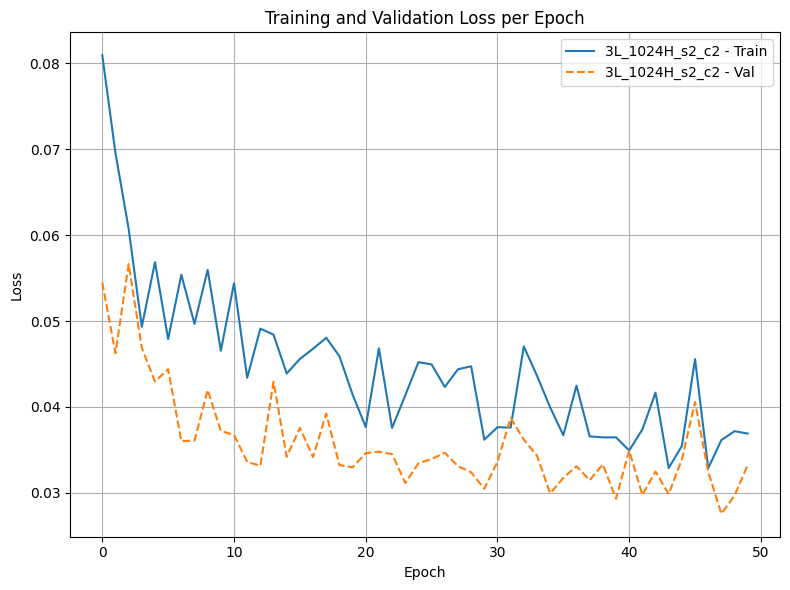

In [ ]:
import matplotlib.pyplot as plt

# Plot training and validation loss for each setting
plt.figure(figsize=(8, 6))

for setting_name, result in results.items():
    plt.plot(result['train_loss'], label=f"{setting_name} - Train")
    plt.plot(result['val_loss'], label=f"{setting_name} - Val", linestyle='--')

plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training and Validation Loss per Epoch")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
for key, value in results.items():
    print(f"{key}: min val_loss = {np.min(value['val_loss']) if len(value['val_loss']) > 0 else 'EMPTY'}")


3L_1024H_s2_c2: min val_loss = 0.027570645881739134


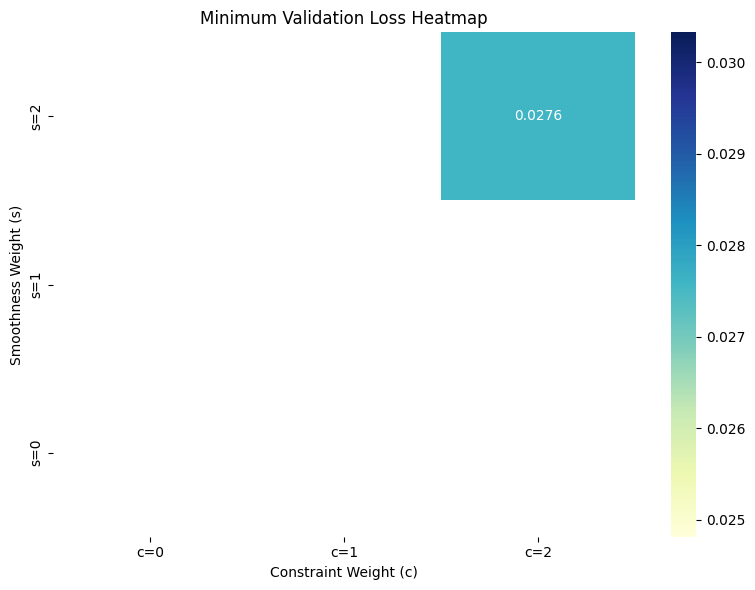

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# 1) 3x3 매트릭스 초기화
min_val_matrix = np.full((3, 3), np.nan)

# 2) key에서 s와 c 파싱해서 matrix 채우기
for key, value in results.items():
    try:
        # 예시: "3L_1024H_s0_c0"
        if "s" in key and "c" in key:
            s_idx = key.index("s")
            c_idx = key.index("c", s_idx)
            s = int(key[s_idx+1:key.index("_", s_idx)])
            c = int(key[c_idx+1:])
            
            val_loss = value['val_loss']
            if isinstance(val_loss, (list, np.ndarray)) and len(val_loss) > 0:
                min_val = float(np.nanmin(val_loss))
                min_val_matrix[s, c] = min_val
    except Exception as e:
        print(f"Key parse failed for '{key}': {e}")

# heatmap 그릴 때 행 방향 뒤집기
flipped_matrix = min_val_matrix[::-1, :]

plt.figure(figsize=(8, 6))
sns.heatmap(flipped_matrix, annot=True, fmt=".4f", cmap="YlGnBu",
            xticklabels=["c=0", "c=1", "c=2"],
            yticklabels=["s=2", "s=1", "s=0"])  # s=0이 아래로
plt.title("Minimum Validation Loss Heatmap")
plt.xlabel("Constraint Weight (c)")
plt.ylabel("Smoothness Weight (s)")
plt.tight_layout()
plt.show()


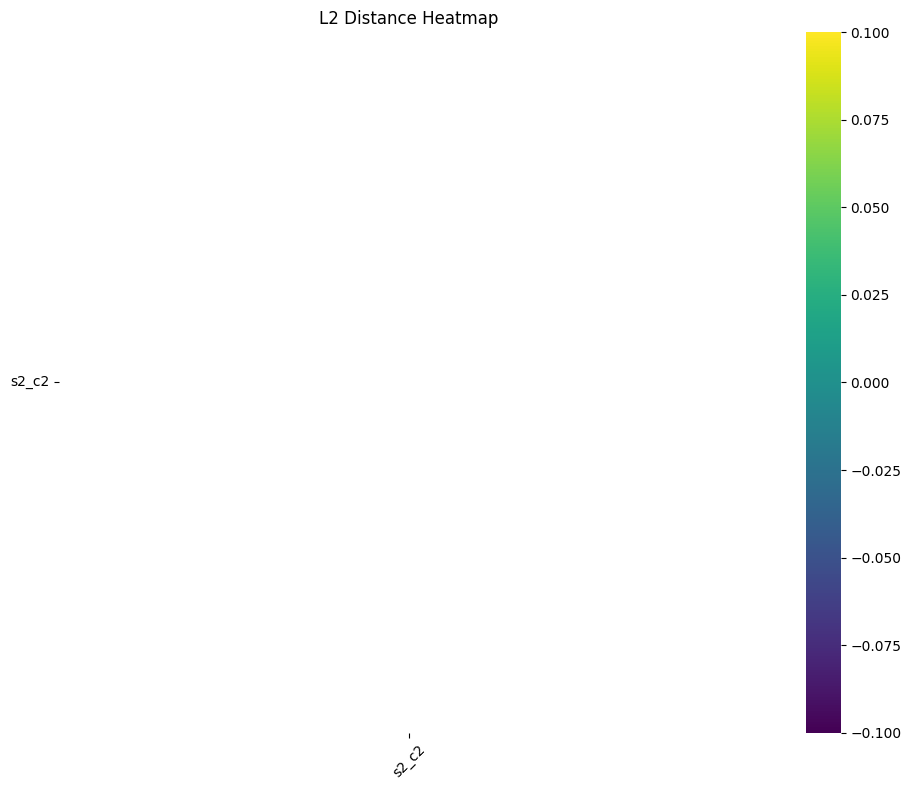

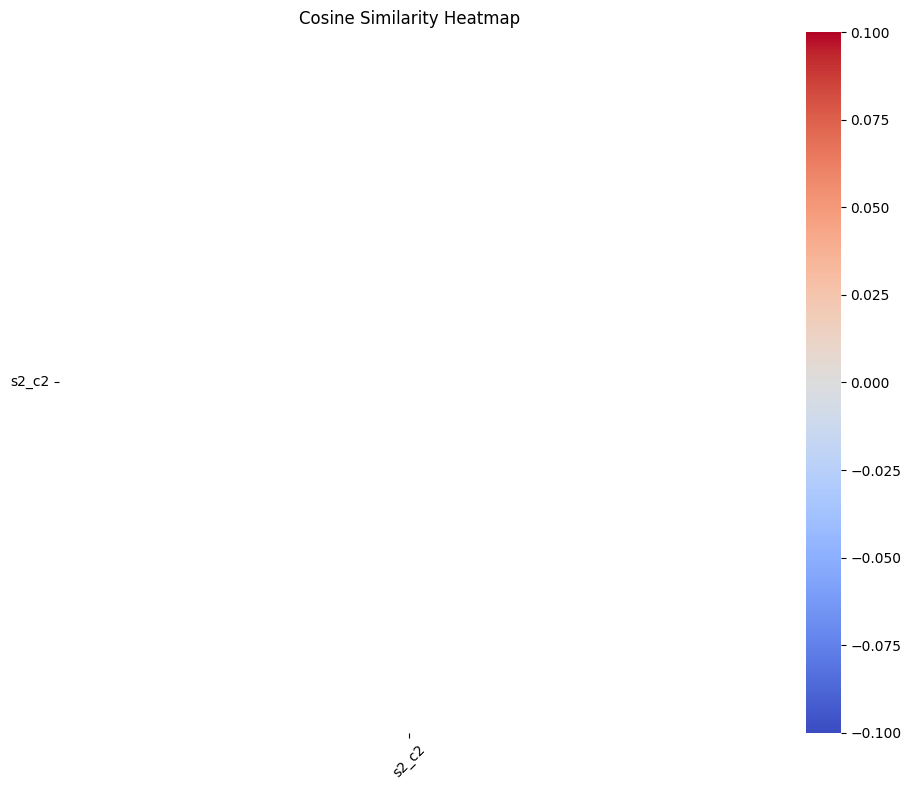

In [ ]:
import os
import torch
import torch.nn.functional as F
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import product

# 1) 가중치 조합 및 경로
smoothness_weights = [2]
constraint_weights = [2]
train_dir = "/home/ftk3187/github/DPC_research/02_DED/2_policy/trainresults"

# 2) 체크포인트 로드 함수
def load_flat_params(s, c):
    fname = f"policy_model_0702_allloss_3L_1024H_s{s}_c{c}.pth"
    path = os.path.join(train_dir, fname)
    sd = torch.load(path, map_location="cpu")
    if isinstance(sd, dict) and "state_dict" in sd:
        sd = sd["state_dict"]
    flat = torch.cat([p.view(-1) for p in sd.values()])
    return flat

# 3) key 및 벡터 생성
keys = list(product(smoothness_weights, constraint_weights))
flats = { (s, c): load_flat_params(s, c) for s, c in keys }

# 4) 유사도 매트릭스 초기화
index = [f"s{s}_c{c}" for s, c in keys]
l2_df = pd.DataFrame(index=index, columns=index, dtype=float)
cosine_df = pd.DataFrame(index=index, columns=index, dtype=float)

# 5) 유사도 계산
for (s1, c1), (s2, c2) in product(keys, keys):
    v1 = flats[(s1, c1)]
    v2 = flats[(s2, c2)]
    l2 = torch.norm(v1 - v2).item()
    cosine = F.cosine_similarity(v1, v2, dim=0).item()
    i1, i2 = f"s{s1}_c{c1}", f"s{s2}_c{c2}"
    l2_df.loc[i1, i2] = l2
    cosine_df.loc[i1, i2] = cosine

#mask = np.triu(np.ones_like(l2_df, dtype=bool))
mask = np.eye(len(l2_df), dtype=bool)

# 6) 히트맵 출력 (y축 반전 포함)
plt.figure(figsize=(10, 8))
sns.heatmap(l2_df[::-1], annot=True, fmt=".2f", cmap="viridis", square=True, mask=mask[::-1])
plt.title("L2 Distance Heatmap")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 8))
sns.heatmap(cosine_df[::-1], annot=True, fmt=".2f", cmap="coolwarm", square=True, mask=mask[::-1])
plt.title("Cosine Similarity Heatmap")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()



In [ ]:
for (s, c) in product(smoothness_weights, constraint_weights):
    v = flats[(s, c)]
    norm = torch.norm(v).item()
    min_val = v.min().item()
    max_val = v.max().item()
    mean = v.mean().item()
    std = v.std().item()
    print(f"[s={s}, c={c}] | L2 norm: {norm:.2f} | min: {min_val:.4f} | max: {max_val:.4f} | mean: {mean:.4f} | std: {std:.4f}")

print("Weight vector size:", flats[(0,0)].numel())  # 예: 135000

[s=2, c=2] | L2 norm: 19.47 | min: -1.2401 | max: 1.8910 | mean: 0.0004 | std: 0.0148


KeyError: (0, 0)